In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import networkx as nx
import warnings
from scipy import stats
warnings.filterwarnings('ignore')

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering

Open access link to dataset: https://archive.ics.uci.edu/dataset/186/wine+quality

In [2]:
import pandas as pd

# Read data from file for red wine
with open('E:/UOL_Semester_3/ST3189_Machine_learning/coursework/CW/DATA/Wine/winequality-red.csv', 'r') as file:
    lines = file.readlines()

# Extract column names and process data
column_names = lines[0].strip().split(';')
processed_data = []

for row_index, row in enumerate(lines[1:]):
    values = row.strip().split(';')
    
    # Create a new dictionary for each row, add a column 'Wine_Type' and mark red wine as 0
    row_dict = {'Wine_Type': '0'}
    for col_name, value in zip(column_names, values):
        row_dict[col_name] = value
    processed_data.append(row_dict)

# Create DataFrame for red wine
df_WR = pd.DataFrame(processed_data)

# Read data from file for white wine
with open('E:/UOL_Semester_3/ST3189_Machine_learning/coursework/CW/DATA/Wine/winequality-white.csv', 'r') as file:
    lines = file.readlines()

# Extract column names and process data
column_names = lines[0].strip().split(';')
processed_data = []

for row_index, row in enumerate(lines[1:]):
    values = row.strip().split(';')
    
    # Create a new dictionary for each row, add a column 'Wine_Type' and mark white wine as 1
    row_dict = {'Wine_Type': '1'}
    for col_name, value in zip(column_names, values):
        row_dict[col_name] = value
    processed_data.append(row_dict)

# Create DataFrame for white wine
df_WW = pd.DataFrame(processed_data)

# Concatenate the two DataFrames
df_combined = pd.concat([df_WR, df_WW], ignore_index=True)

# Set display option to left-justify column headers
df_combined.columns = df_combined.columns.str.replace('"', '')

# Display the combined DataFrame without quotation marks around column names
df_combined.head()

,Wine_Type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.7,0,1.9,0.076,11,34,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.88,0,2.6,0.098,25,67,0.9968,3.2,0.68,9.8,5
2,0,7.8,0.76,0.04,2.3,0.092,15,54,0.997,3.26,0.65,9.8,5
3,0,11.2,0.28,0.56,1.9,0.075,17,60,0.998,3.16,0.58,9.8,6
4,0,7.4,0.7,0,1.9,0.076,11,34,0.9978,3.51,0.56,9.4,5


Red wine marked as 0, White wine marked as 1

In [3]:
# Display the combined DataFrame without quotation marks around column names
df_combined.tail()

,Wine_Type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
6492,1,6.2,0.21,0.29,1.6,0.039,24,92,0.99114,3.27,0.5,11.2,6
6493,1,6.6,0.32,0.36,8,0.047,57,168,0.9949,3.15,0.46,9.6,5
6494,1,6.5,0.24,0.19,1.2,0.041,30,111,0.99254,2.99,0.46,9.4,6
6495,1,5.5,0.29,0.3,1.1,0.022,20,110,0.98869,3.34,0.38,12.8,7
6496,1,6,0.21,0.38,0.8,0.02,22,98,0.98941,3.26,0.32,11.8,6


In [4]:
df_combined.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Wine_Type             6497 non-null   object
 1   fixed acidity         6497 non-null   object
 2   volatile acidity      6497 non-null   object
 3   citric acid           6497 non-null   object
 4   residual sugar        6497 non-null   object
 5   chlorides             6497 non-null   object
 6   free sulfur dioxide   6497 non-null   object
 7   total sulfur dioxide  6497 non-null   object
 8   density               6497 non-null   object
 9   pH                    6497 non-null   object
 10  sulphates             6497 non-null   object
 11  alcohol               6497 non-null   object
 12  quality               6497 non-null   object
dtypes: object(13)
memory usage: 660.0+ KB


In [5]:
df_combined.shape

(6497, 13)

## Drop duplicate

In [6]:
#Find the number of duplicated rows.
print("The number of duplicated rows is {}.".format(df_combined.duplicated().sum())) 

# Drop duplicates 
df_combined.drop_duplicates(inplace=True)

The number of duplicated rows is 1177.


In [7]:
# Check once again after dropping.
print('The number of duplicated rows is {}.'.format(df_combined.duplicated().sum()))

The number of duplicated rows is 0.


There is no duplicate in the origin dataframe.We can continue processing the data.

## Handle the Null Value

In [8]:
df_combined.isnull().sum()

Wine_Type               0
fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

In [9]:
# Replace the null value with 0.
df_combined=df_combined.fillna(0)

In [10]:
#check null values again to ensure no more null value.
df_combined.isnull().sum()

Wine_Type               0
fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

# Data type conversion

In [11]:
print(df_combined.dtypes)

Wine_Type               object
fixed acidity           object
volatile acidity        object
citric acid             object
residual sugar          object
chlorides               object
free sulfur dioxide     object
total sulfur dioxide    object
density                 object
pH                      object
sulphates               object
alcohol                 object
quality                 object
dtype: object


In [12]:
# Display the data types of each column
column_dtypes = df_combined.dtypes

# Print columns that are not of type float or int
non_numeric_columns = column_dtypes[column_dtypes.apply(lambda x: x not in ['float64', 'int64'])]

print("Columns with non-float and non-int data types:")

Columns with non-float and non-int data types:


In [13]:
# Loop over each column in the dataframe 'df_combined'
for column in df_combined.columns:
    # Calculate the unique values within the current column
    unique_values = df_combined[column].unique()
    # Print the column name and its unique values
    print(f'Column: {column}, Unique Values: {unique_values}')


Column: Wine_Type, Unique Values: ['0' '1']
Column: fixed acidity, Unique Values: ['7.4' '7.8' '11.2' '7.9' '7.3' '7.5' '6.7' '5.6' '8.9' '8.5' '8.1' '7.6'
 '6.9' '6.3' '7.1' '8.3' '5.2' '5.7' '8.8' '6.8' '4.6' '7.7' '8.7' '6.4'
 '6.6' '8.6' '10.2' '7' '7.2' '9.3' '8' '9.7' '6.2' '5' '4.7' '8.4' '10.1'
 '9.4' '9' '8.2' '6.1' '5.8' '9.2' '11.5' '5.4' '9.6' '12.8' '11' '11.6'
 '12' '15' '10.8' '11.1' '10' '12.5' '11.8' '10.9' '10.3' '11.4' '9.9'
 '10.4' '13.3' '10.6' '9.8' '13.4' '10.7' '11.9' '12.4' '12.2' '13.8'
 '9.1' '13.5' '10.5' '12.6' '14' '13.7' '9.5' '12.7' '12.3' '15.6' '5.3'
 '11.3' '13' '6.5' '12.9' '14.3' '15.5' '11.7' '13.2' '15.9' '12.1' '5.1'
 '4.9' '5.9' '6' '5.5' '4.8' '14.2' '6.15' '4.5' '7.15' '6.45' '4.2' '3.8'
 '4.4' '3.9']
Column: volatile acidity, Unique Values: ['0.7' '0.88' '0.76' '0.28' '0.66' '0.6' '0.65' '0.58' '0.5' '0.615'
 '0.61' '0.62' '0.56' '0.59' '0.32' '0.22' '0.39' '0.43' '0.49' '0.4'
 '0.41' '0.71' '0.645' '0.675' '0.685' '0.655' '0.605' '0.38' '1.1

Column: pH, Unique Values: ['3.51' '3.2' '3.26' '3.16' '3.3' '3.39' '3.36' '3.35' '3.28' '3.58'
 '3.17' '3.11' '3.38' '3.04' '3.52' '3.43' '3.34' '3.47' '3.46' '3.45'
 '3.4' '3.42' '3.23' '3.5' '3.33' '3.21' '3.48' '3.9' '3.25' '3.32' '3.15'
 '3.41' '3.44' '3.31' '3.54' '3.13' '2.93' '3.14' '3.75' '3.85' '3.29'
 '3.08' '3.37' '3.19' '3.07' '3.49' '3.53' '3.24' '3.63' '3.22' '3.68'
 '2.74' '3.59' '3' '3.12' '3.57' '3.61' '3.06' '3.6' '3.69' '3.1' '3.05'
 '3.67' '3.27' '3.18' '3.02' '3.55' '2.99' '3.01' '3.56' '3.03' '3.62'
 '2.88' '2.95' '2.98' '3.09' '2.86' '3.74' '2.92' '3.72' '2.87' '2.89'
 '2.94' '3.66' '3.71' '3.78' '3.7' '4.01' '2.9' '2.96' '2.97' '3.64'
 '2.85' '3.82' '3.81' '3.65' '3.77' '2.91' '2.8' '2.72' '2.79' '3.8'
 '2.77' '3.79' '2.84' '3.76' '2.83' '2.82']
Column: sulphates, Unique Values: ['0.56' '0.68' '0.65' '0.58' '0.46' '0.47' '0.57' '0.8' '0.54' '0.52'
 '1.56' '0.88' '0.93' '0.75' '1.28' '0.5' '1.08' '0.53' '0.91' '0.63'
 '0.59' '0.55' '0.66' '0.6' '0.73' '0.48' '0.

In [14]:
# List of columns to convert to float
columns_to_convert_float = ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides',
                      'density', 'pH', 'sulphates', 'alcohol','free sulfur dioxide','total sulfur dioxide']

# List of columns to convert to int
columns_to_convert_int = ['quality', 'Wine_Type']

# Convert specified columns to float
df_combined[columns_to_convert_float] = df_combined[columns_to_convert_float].apply(pd.to_numeric, errors='coerce')

# Convert specified columns to int
df_combined[columns_to_convert_int] = df_combined[columns_to_convert_int].astype(int)

# Print updated data types
print(df_combined.dtypes)

Wine_Type                 int32
fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                   int32
dtype: object


In [15]:
df_combined.tail(25)

,Wine_Type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
6471,1,6.0,0.420,0.41,12.40,0.032,50.0,179.0,0.99622,3.14,0.60,9.700000,5
6472,1,5.7,0.210,0.32,1.60,0.030,33.0,122.0,0.99044,3.33,0.52,11.900000,6
6473,1,5.6,0.200,0.36,2.50,0.048,16.0,125.0,0.99282,3.49,0.49,10.000000,6
6474,1,7.4,0.220,0.26,1.20,0.035,18.0,97.0,0.99245,3.12,0.41,9.700000,6
6475,1,6.2,0.380,0.42,2.50,0.038,34.0,117.0,0.99132,3.36,0.59,11.600000,7
6476,1,5.9,0.540,0.00,0.80,0.032,12.0,82.0,0.99286,3.25,0.36,8.800000,5
6477,1,6.2,0.530,0.02,0.90,0.035,6.0,81.0,0.99234,3.24,0.35,9.500000,4
6478,1,6.6,0.340,0.40,8.10,0.046,68.0,170.0,0.99494,3.15,0.50,9.533333,6
6480,1,5.0,0.235,0.27,11.75,0.030,34.0,118.0,0.99540,3.07,0.50,9.400000,6
6481,1,5.5,0.320,0.13,1.30,0.037,45.0,156.0,0.99184,3.26,0.38,10.700000,5


# Deal with the outlier

In [16]:
# Define a list of column names that represent features in a wine dataset
Feature_Col = ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides','quality', 'Wine_Type',
               'density', 'pH', 'sulphates', 'alcohol','free sulfur dioxide','total sulfur dioxide']

In [17]:
# Define a function to handle outliers for a specific column
def handle_outliers(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    # Identify outliers based on IQR
    outliers = (column < Q1 - 1.5 * IQR) | (column > Q3 + 1.5 * IQR)
    # Handle outliers
    column[outliers] = column.median()  # Replace outliers with median
    return column

# Apply the function to all numeric columns in the DataFrame
numeric_columns = df_combined.select_dtypes(include=['number']).columns
df_combined[numeric_columns] = df_combined[numeric_columns].apply(handle_outliers, axis=0)
# Create df_cleaned 
df_cleaned = df_combined[numeric_columns]
df_cleaned.describe().T.style.background_gradient(cmap = "gist_yarg")

,count,mean,std,min,25%,50%,75%,max
Wine_Type,5320.000000,0.744549,0.436155,0.000000,0.000000,1.000000,1.000000,1.000000
fixed acidity,5320.000000,6.995968,0.898370,4.500000,6.400000,7.000000,7.500000,9.600000
volatile acidity,5320.000000,0.317660,0.125361,0.080000,0.230000,0.300000,0.380000,0.675000
citric acid,5320.000000,0.306966,0.128077,0.000000,0.240000,0.310000,0.380000,0.640000
residual sugar,5320.000000,4.629784,3.861351,0.600000,1.800000,2.700000,6.900000,16.050000
chlorides,5320.000000,0.050897,0.018583,0.009000,0.038000,0.047000,0.060000,0.108000
free sulfur dioxide,5320.000000,29.440695,16.329848,1.000000,16.000000,28.000000,40.000000,78.000000
total sulfur dioxide,5320.000000,113.722368,56.017231,6.000000,74.000000,116.000000,153.000000,272.000000
density,5320.000000,0.994522,0.002891,0.987110,0.992200,0.994645,0.996760,1.003200
pH,5320.000000,3.220455,0.152148,2.790000,3.120000,3.210000,3.320000,3.660000


In [18]:
df_cleaned.tail(25)

,Wine_Type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
6471,1,6.0,0.420,0.41,12.40,0.032,50.0,179.0,0.99622,3.14,0.60,9.700000,5
6472,1,5.7,0.210,0.32,1.60,0.030,33.0,122.0,0.99044,3.33,0.52,11.900000,6
6473,1,5.6,0.200,0.36,2.50,0.048,16.0,125.0,0.99282,3.49,0.49,10.000000,6
6474,1,7.4,0.220,0.26,1.20,0.035,18.0,97.0,0.99245,3.12,0.41,9.700000,6
6475,1,6.2,0.380,0.42,2.50,0.038,34.0,117.0,0.99132,3.36,0.59,11.600000,7
6476,1,5.9,0.540,0.00,0.80,0.032,12.0,82.0,0.99286,3.25,0.36,8.800000,5
6477,1,6.2,0.530,0.02,0.90,0.035,6.0,81.0,0.99234,3.24,0.35,9.500000,4
6478,1,6.6,0.340,0.40,8.10,0.046,68.0,170.0,0.99494,3.15,0.50,9.533333,6
6480,1,5.0,0.235,0.27,11.75,0.030,34.0,118.0,0.99540,3.07,0.50,9.400000,6
6481,1,5.5,0.320,0.13,1.30,0.037,45.0,156.0,0.99184,3.26,0.38,10.700000,5


### Add Decanted residual acidity

In [19]:
# Calculation logic of residual acidity
df_cleaned['residual acidity'] = df_cleaned['fixed acidity'] - df_cleaned['volatile acidity']

# Get the index of the "volatile acidity" column
volatile_acidity_index = df_cleaned.columns.get_loc('volatile acidity')

# Insert the "residual acidity" column to the right of the "volatile acidity" column
df_cleaned.insert(volatile_acidity_index + 1, 'Decanted residual acidity ', df_cleaned.pop('residual acidity'))

In [20]:
df_cleaned.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,40.0,0.9978,3.51,0.56,9.4,5


### Add Decanted sulfur dioxide 

In [21]:
df_cleaned.head(20)

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.300,7.100,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.300,7.500,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,0,7.8,0.300,7.500,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,0,7.0,0.280,6.720,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
5,0,7.4,0.660,6.740,0.00,1.8,0.075,13.0,40.0,0.9978,3.51,0.56,9.4,5
6,0,7.9,0.600,7.300,0.06,1.6,0.069,15.0,59.0,0.9964,3.30,0.46,9.4,5
7,0,7.3,0.650,6.650,0.00,1.2,0.065,15.0,21.0,0.9946,3.39,0.47,10.0,7
8,0,7.8,0.580,7.220,0.02,2.0,0.073,9.0,18.0,0.9968,3.36,0.57,9.5,7
9,0,7.5,0.500,7.000,0.36,6.1,0.071,17.0,102.0,0.9978,3.35,0.80,10.5,5
10,0,6.7,0.580,6.120,0.08,1.8,0.097,15.0,65.0,0.9959,3.28,0.54,9.2,5


In [22]:
# Calculate the "Decanted residual sulfur dioxide"
df_cleaned['residual sulfur dioxide'] = df_cleaned['total sulfur dioxide'] - df_cleaned['free sulfur dioxide']

# Get the index of the "volatile acidity" column
free_sulfur_dioxide_index = df_cleaned.columns.get_loc('free sulfur dioxide')

# Insert the "Decanted residual sulfur dioxide" column to the right of the "free sulfur dioxide" column
df_cleaned.insert(free_sulfur_dioxide_index + 1, 'Decanted residual sulfur dioxide', df_cleaned.pop('residual sulfur dioxide'))


In [23]:
df_cleaned.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5


##### Together, these terms describe various chemical and sensory characteristics of wine and are commonly used in wine analysis and quality assessment.


Wine type:
0 means red wine, 1 might mean white wine.

Fixed acidity:
Fixed acidity is a measure of the total concentration of all non-volatile acids in a wine.

Volatile acidity:
Volatile acidity indicates the amount of volatile acid in a wine, and too high a level can result in an unpleasant taste and smell.

Citric acid:
Citric acid is the fixed acid in wine. It contributes to the overall acidity and also adds lemon flavor. (can be 0)

Residual sugar:
Residual sugar refers to the amount of sugar left in the wine after fermentation, which affects the sweetness of the wine.

chloride:
Chloride indicates the concentration of salt in wine. Chloride content affects taste and saltiness perception.

Free sulfur dioxide:
Free sulfur dioxide is the content of free SO2 in wine. It acts as a preservative and antioxidant.

Total sulfur dioxide:
Total sulfur dioxide is the sum of free and bound forms of sulfur dioxide in wine. It is also related to the stability and aging ability of the wine.

density:
Density is the ratio of mass to volume of wine. It is affected by sugar and alcohol concentration.

pH:
pH is a measure of how acidic or alkaline a wine is. A pH value less than 7 means acidic, and a pH value greater than 7 means alkaline.

Sulfate:
Sulfates, or sulfur compounds, are often added to wine as preservatives. They also add aroma to wine.

Alcohol:
Alcohol content is the percentage of alcohol in a wine. It is an important factor in determining the body and taste of wine.

quality:
Quality is a subjective measure that is often affected by a combination of factors. It represents the overall evaluation of the wine.

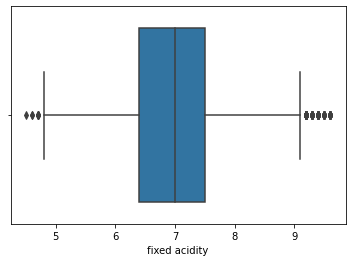

In [24]:
# Create box plots for fixed acidity
sns.boxplot(x=df_combined['fixed acidity'])
plt.show()

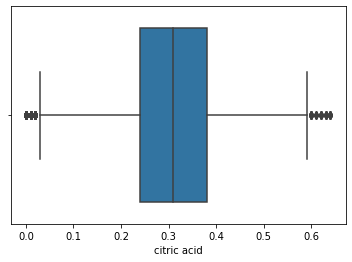

In [25]:
# Create box plots for citric acid
sns.boxplot(x=df_combined['citric acid'])
plt.show()

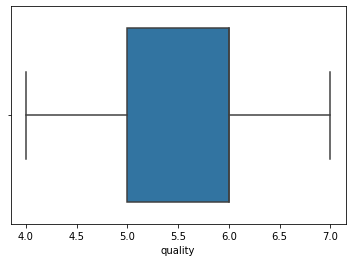

In [26]:
# Create box plots for quality
sns.boxplot(x=df_combined['quality'])
plt.show()

It turns out that the dataset does not have null values. The dataset consists of 1599 rows and 12 columns. The data type of all variables are numeric.

### Prepare the both red and white dataframe

In [27]:
# Filter the DataFrame for red wine (Wine_Type 0)
red_wine_df = df_cleaned[df_cleaned['Wine_Type'] == 0]

# Filter the DataFrame for white wine (Wine_Type 1)
white_wine_df = df_cleaned[df_cleaned['Wine_Type'] == 1]

In [28]:
# Drop the 'Wine_Type' column in-place
red_wine_df.drop('Wine_Type', axis=1, inplace=True)

In [29]:
red_wine_df.tail()

,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
1593,6.8,0.620,6.180,0.08,1.9,0.068,28.0,10.0,38.0,0.99651,3.42,0.82,9.5,6
1594,6.2,0.600,5.600,0.08,2.0,0.090,32.0,12.0,44.0,0.99490,3.45,0.58,10.5,5
1595,5.9,0.550,5.350,0.10,2.2,0.062,39.0,12.0,51.0,0.99512,3.52,0.76,11.2,6
1597,5.9,0.645,5.255,0.12,2.0,0.075,32.0,12.0,44.0,0.99547,3.57,0.71,10.2,5
1598,6.0,0.310,5.690,0.47,3.6,0.067,18.0,24.0,42.0,0.99549,3.39,0.66,11.0,6


In [30]:
# Drop the 'Wine_Type' column in-place
white_wine_df.drop('Wine_Type', axis=1, inplace=True)

In [31]:
white_wine_df.head(10)

,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
1599,7.0,0.27,6.73,0.36,2.70,0.045,45.0,125.0,170.0,1.0010,3.00,0.45,8.8,6
1600,6.3,0.30,6.00,0.34,1.60,0.049,14.0,118.0,132.0,0.9940,3.30,0.49,9.5,6
1601,8.1,0.28,7.82,0.40,6.90,0.050,30.0,67.0,97.0,0.9951,3.26,0.44,10.1,6
1602,7.2,0.23,6.97,0.32,8.50,0.058,47.0,139.0,186.0,0.9956,3.19,0.40,9.9,6
1605,6.2,0.32,5.88,0.16,7.00,0.045,30.0,106.0,136.0,0.9949,3.18,0.47,9.6,6
1608,8.1,0.22,7.88,0.43,1.50,0.044,28.0,101.0,129.0,0.9938,3.22,0.45,11.0,6
1609,8.1,0.27,7.83,0.41,1.45,0.033,11.0,52.0,63.0,0.9908,2.99,0.56,12.0,5
1610,8.6,0.23,8.37,0.40,4.20,0.035,17.0,92.0,109.0,0.9947,3.14,0.53,9.7,5
1611,7.9,0.18,7.72,0.37,1.20,0.040,16.0,59.0,75.0,0.9920,3.18,0.63,10.8,5
1612,6.6,0.16,6.44,0.40,1.50,0.044,48.0,95.0,143.0,0.9912,3.54,0.52,12.4,7


## Explortary Analysis

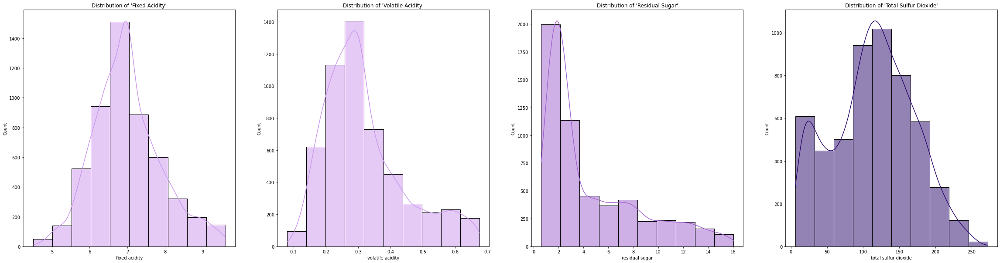

In [32]:
# Create a 1x4 grid of subplots with a size of 40x10 inches
fig, axes = plt.subplots(1, 4, figsize=(40, 10))

# Plot a histogram for 'fixed acidity' on the first subplot (axes[0])
sns.histplot(ax=axes[0], x=df_cleaned["fixed acidity"],
             bins=10,  # Use 10 bins for the histogram
             kde=True,  # Overlay the Kernel Density Estimate (KDE)
             cbar=True,  # Show a color bar representing frequency of data
             color="#CA96EC").set(title="Distribution of 'Fixed Acidity'");

# Plot a histogram for 'volatile acidity' on the second subplot (axes[1])
sns.histplot(ax=axes[1], x=df_cleaned["volatile acidity"],
             bins=10,  # Use 10 bins for the histogram
             kde=True,  # Overlay the KDE
             cbar=True,  # Show a color bar
             color="#CA96EC").set(title="Distribution of 'Volatile Acidity'"); 

# Plot a histogram for 'residual sugar' on the third subplot (axes[2])
sns.histplot(ax=axes[2], x=df_cleaned["residual sugar"],
             bins=10,  # Use 10 bins
             cbar=True,  # Show a color bar
             kde=True,  # Overlay the KDE
             color="#A163CF").set(title="Distribution of 'Residual Sugar'"); 

# Plot a histogram for 'total sulfur dioxide' on the fourth subplot (axes[3])
sns.histplot(ax=axes[3], x=df_cleaned["total sulfur dioxide"],
             bins=10,  # Use 10 bins
             kde=True,  # Overlay the KDE
             cbar=True,  # Show a color bar
             color="#29066B").set(title="Distribution of 'Total Sulfur Dioxide'"); 

Distribution of 'Fixed Acidity' shows a normal distribution.
Distribution of 'Volatile Acidity' shows a right skewed distribution
Distribution of 'Residual Sugar' shows a right skewed distribution
Distribution of 'Total Sulfur Dioxide'shows two skewed distribution


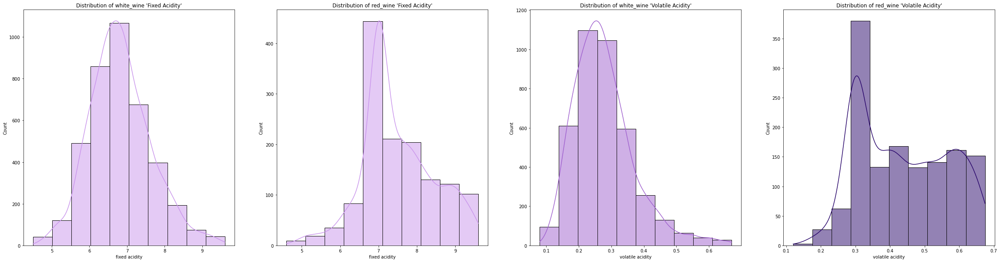

In [33]:
# Create a 1-row, 4-column grid of subplots with a figure size of 40x10 inches
fig, axes = plt.subplots(1, 4, figsize=(40, 10))

# Create a histogram on the first subplot for 'fixed acidity' from the white wine dataset
sns.histplot(ax=axes[0], x=white_wine_df["fixed acidity"],
             bins=10,  # Set the number of bins for the histogram
             kde=True,  # Add a Kernel Density Estimate (KDE) to smooth the histogram
             cbar=True,  # Include a color bar to show the scale of counts
             color="#CA96EC").set(title="Distribution of white_wine 'Fixed Acidity'");  # Set the plot color and title

# Create a histogram on the second subplot for 'fixed acidity' from the red wine dataset
sns.histplot(ax=axes[1], x=red_wine_df["fixed acidity"],
             bins=10,  # Set the number of bins for the histogram
             kde=True,  # Add KDE
             cbar=True,  # Include a color bar
             color="#CA96EC").set(title="Distribution of red_wine 'Fixed Acidity'");  # Set the plot color and title

# Create a histogram on the third subplot for 'volatile acidity' from the white wine dataset
sns.histplot(ax=axes[2], x=white_wine_df["volatile acidity"],
             bins=10,  # Set the number of bins for the histogram
             cbar=True,  # Include a color bar
             kde=True,  # Add KDE
             color="#A163CF").set(title="Distribution of white_wine 'Volatile Acidity'");  # Set the plot color and title

# Create a histogram on the fourth subplot for 'volatile acidity' from the red wine dataset
sns.histplot(ax=axes[3], x=red_wine_df["volatile acidity"],
             bins=10,  # Set the number of bins for the histogram
             kde=True,  # Add KDE
             cbar=True,  # Include a color bar
             color="#29066B").set(title="Distribution of red_wine 'Volatile Acidity'");  # Set the plot color and title


Fixed Acidity for white wine shows a normal distribution.  
Fixed Acidity for red wine shows a left skewed distribution.  
volatile acidity for white wine shows a right skewed distribution.  
volatile acidity for red wine shows a left skewed distribution.  

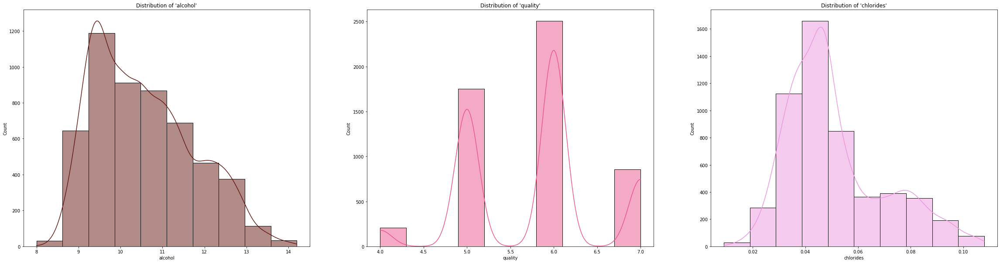

In [34]:
# Create a 1x3 subplot structure with a figure size of 40x10 inches
fig, axes = plt.subplots(1, 3, figsize=(40, 10))
# First histogram for the 'alcohol' variable
sns.histplot(ax = axes[0], x = df_cleaned["alcohol"],
             bins = 10,    
             kde = True,
             cbar = True,
             color = "#641811").set(title = "Distribution of 'alcohol'");
# Second histogram for the 'quality' variable
sns.histplot(ax = axes[1], x = df_cleaned["quality"],
             bins = 10,
             kde = True,
             cbar = True,
             color = "#EB548C").set(title = "Distribution of 'quality'");
# Third histogram for the 'chlorides' variable
sns.histplot(ax = axes[2], x = df_cleaned["chlorides"],
             bins = 10,
             kde = True,   
             cbar = True,
             color = "#EC96E0").set(title = "Distribution of 'chlorides'");

### Pairplot (Correlationship)

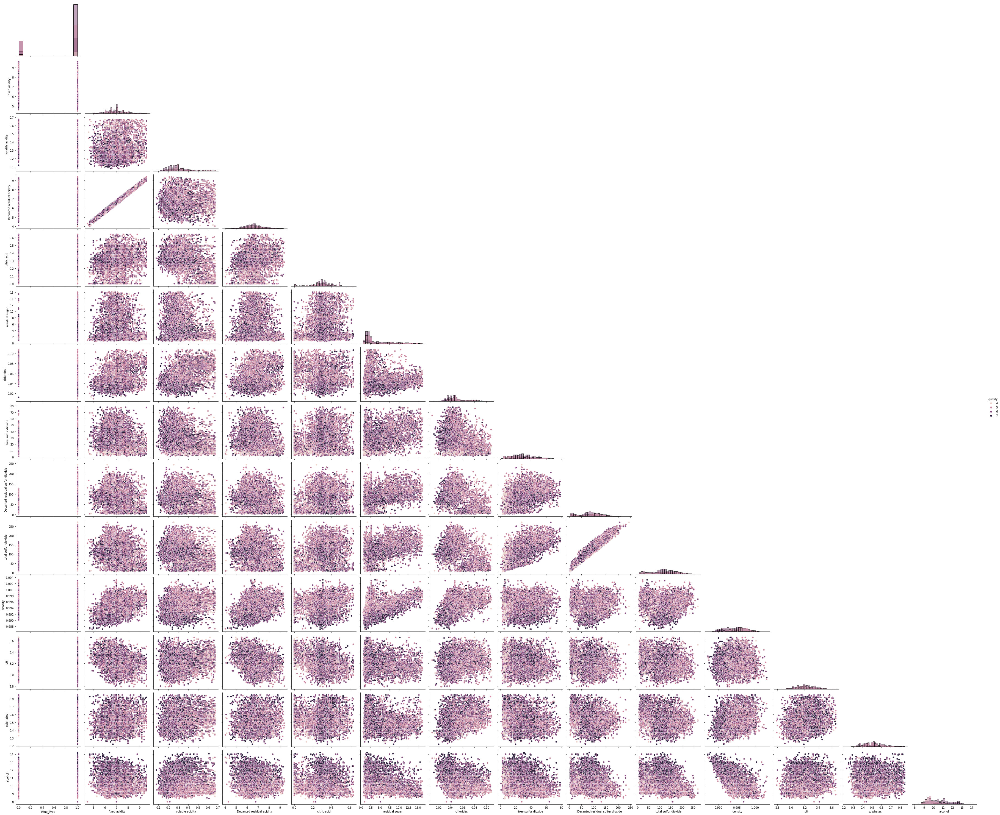

In [35]:
# Generate a corner pairplot of the DataFrame.
sns.pairplot(df_cleaned, diag_kind = "hist", hue = "quality", height = 3, aspect = 1.2, corner = True);

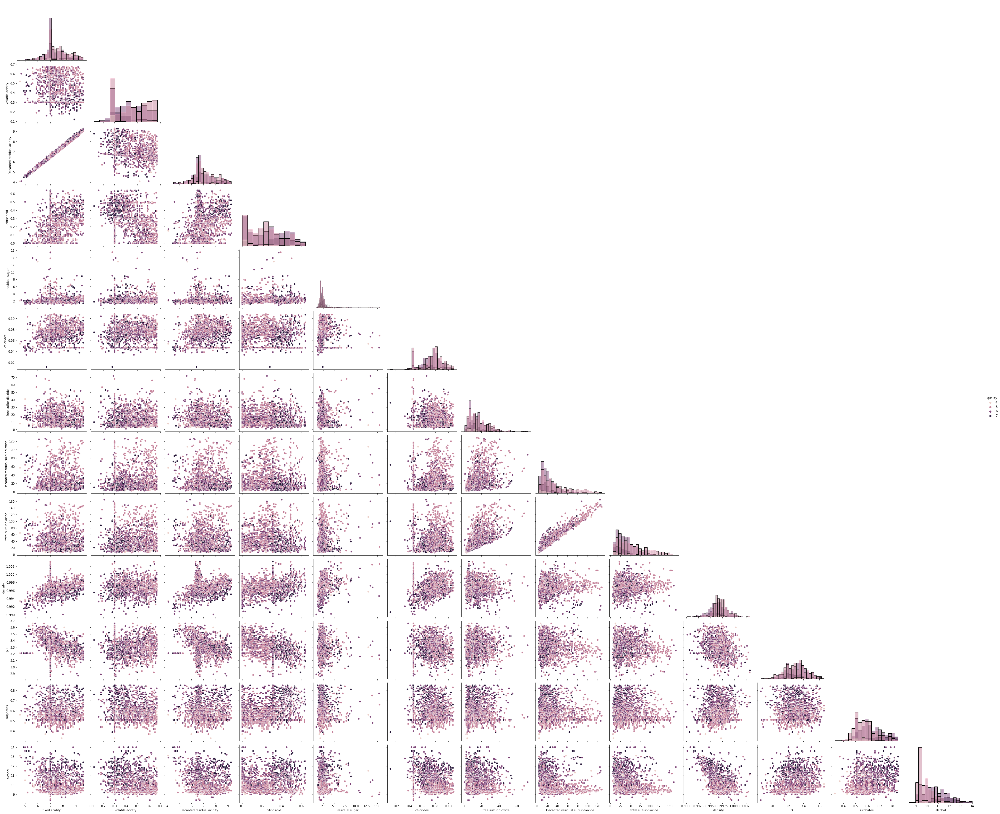

In [36]:
# Generate a corner pairplot of the DataFrame.
sns.pairplot(red_wine_df, diag_kind = "hist", hue = "quality", height = 3, aspect = 1.2, corner = True);

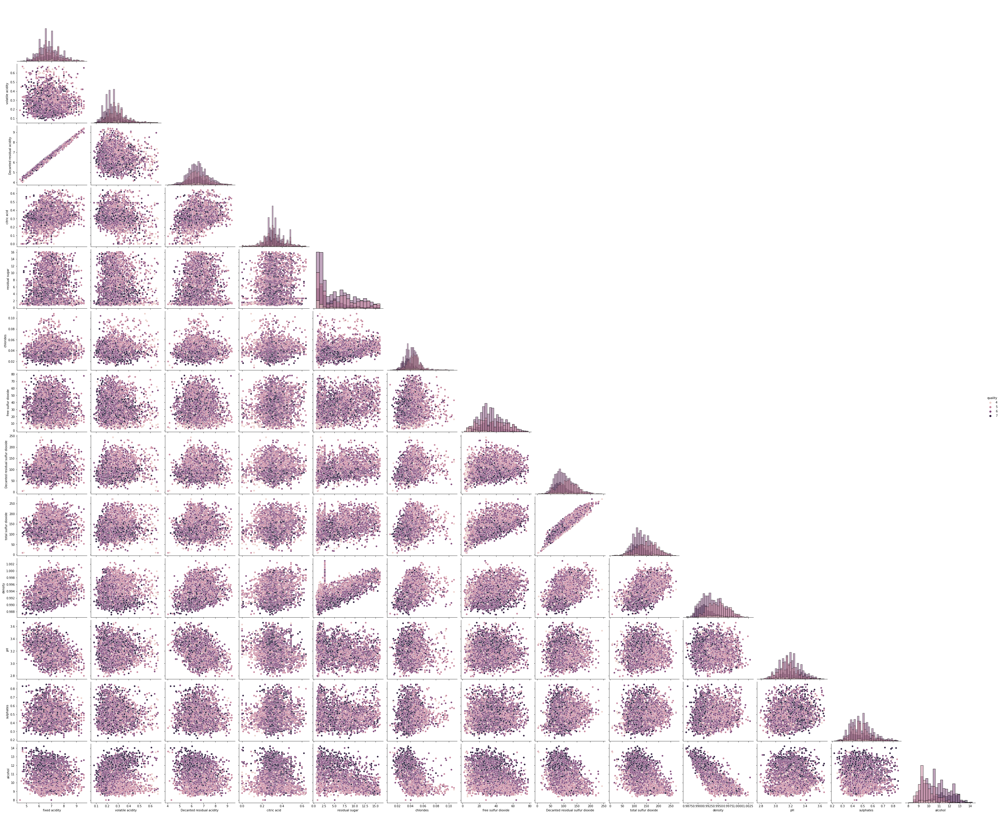

In [37]:
# Generate a corner pairplot of the DataFrame.
sns.pairplot(white_wine_df, diag_kind = "hist", hue = "quality", height = 3, aspect = 1.2, corner = True);

Multicollinearity detected !
We see here that there is correlation between some variables. And this is what we don't want. This problem is called 'multicollinearity'

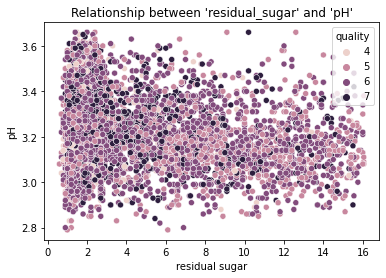

In [38]:
# Create a scatter plot using Seaborn library.
sns.scatterplot(x = "residual sugar",
                y = "pH",
                hue = "quality",
                data = df_cleaned).set(title = "Relationship between 'residual_sugar' and 'pH'");

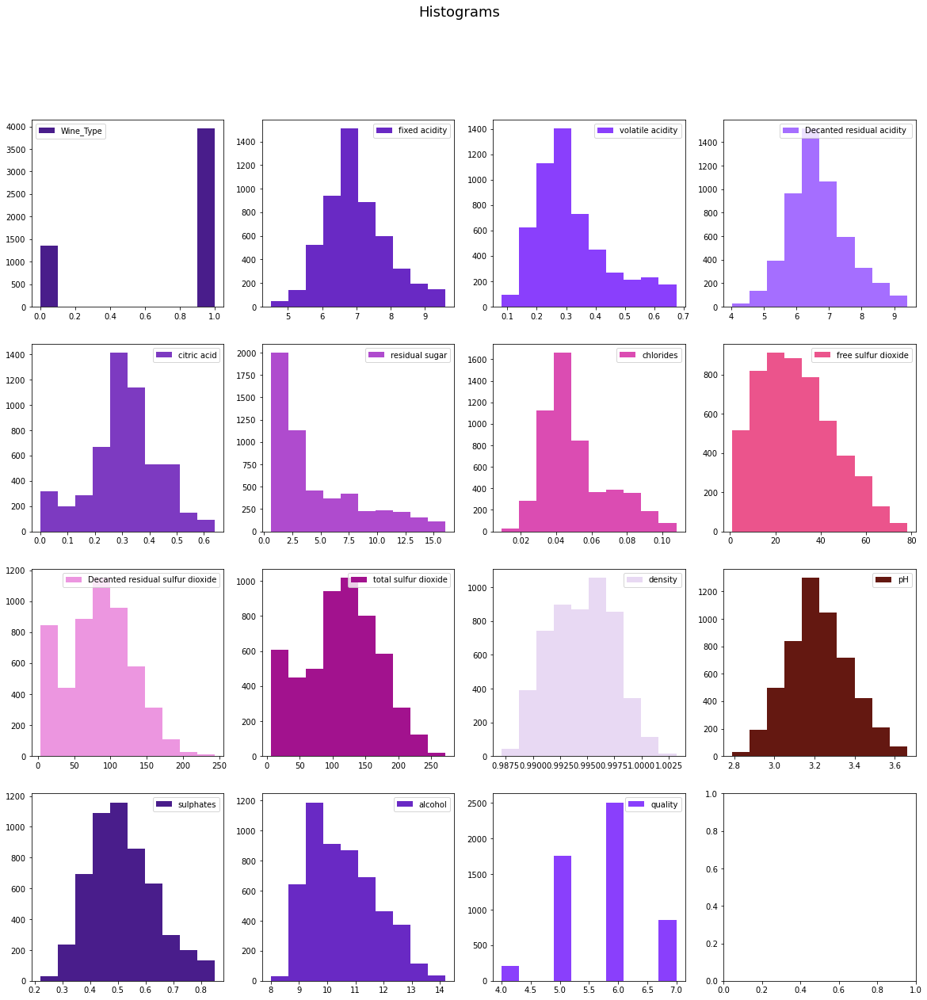

In [39]:
# Set up a 4x4 grid of subplots with a figure size of 20 by 20 inches.
fig, axes = plt.subplots(nrows = 4, ncols = 4, figsize = (20, 20))

# Define a list of colors to be used for the histograms.
colors = ['#491D8B', '#6929C4', '#8A3FFC', '#A56EFF',
          '#7D3AC1', '#AF4BCE', '#DB4CB2', '#EB548C',
          '#EC96E0', '#A2128E', '#E8D9F3', '#641811']*2
# Loop through all columns in the dataframe and create a histogram for each.
for index, column in enumerate(df_cleaned.columns): # 'enumerate' provides the index and the column name from df_cleaned.
    ax = axes.flatten()[index]
    ax.hist(df_cleaned[column], color = colors[index % len(colors)], label = column)
    ax.legend(loc = "best")
plt.suptitle("Histograms", size = 18)

plt.show()

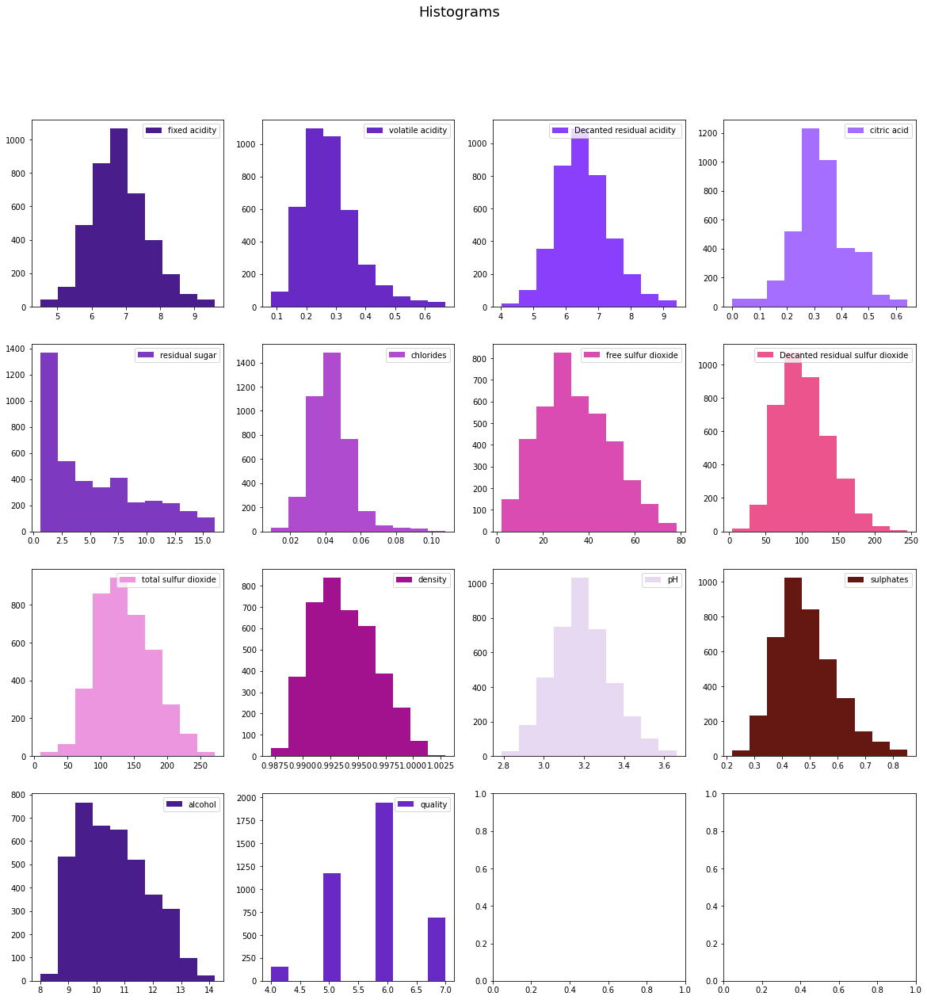

In [40]:
# Set up a 4x4 grid of subplots with a figure size of 20 by 20 inches.
fig, axes = plt.subplots(nrows = 4, ncols = 4, figsize = (20, 20))

# Define a list of colors to be used for the histograms.
colors = ['#491D8B', '#6929C4', '#8A3FFC', '#A56EFF',
          '#7D3AC1', '#AF4BCE', '#DB4CB2', '#EB548C',
          '#EC96E0', '#A2128E', '#E8D9F3', '#641811']*2
# Loop through all columns in the dataframe and create a histogram for each.
for index, column in enumerate(white_wine_df.columns):
    ax = axes.flatten()[index]
    ax.hist(white_wine_df[column], color = colors[index % len(colors)], label = column)
    ax.legend(loc = "best")
plt.suptitle("Histograms", size = 18)

plt.show()

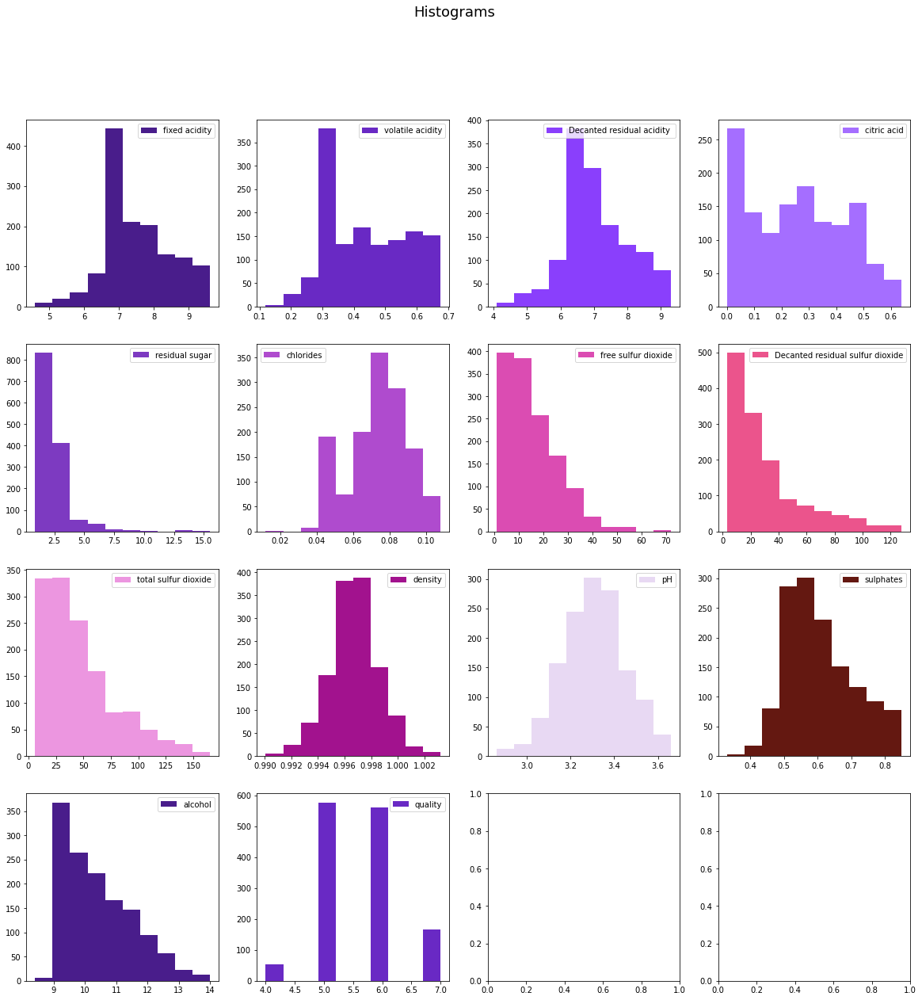

In [41]:
fig, axes = plt.subplots(nrows = 4, ncols = 4, figsize = (20, 20))

colors = ['#491D8B', '#6929C4', '#8A3FFC', '#A56EFF',
          '#7D3AC1', '#AF4BCE', '#DB4CB2', '#EB548C',
          '#EC96E0', '#A2128E', '#E8D9F3', '#641811']*2

for index, column in enumerate(red_wine_df.columns):
    ax = axes.flatten()[index]
    ax.hist(red_wine_df[column], color = colors[index % len(colors)], label = column)
    ax.legend(loc = "best")
plt.suptitle("Histograms", size = 18)

plt.show()

fixed acidity: most acids involved with wine or fixed or nonvolatile (do not evaporate readily). Acidity is a characteristic determined by the total sum of acids that a sample contains. We can quantify the set of all of them in an undifferentiated way (total acidity) or in a grouped way (fixed acidity and volatile acidity). Fixed acidity corresponds to the set of low volatility organic acids such as malic, lactic, tartaric or citric acids and is inherent to the characteristics of the sample.

volatile acidity: the amount of acetic acid in wine, which at too high of levels can lead to an unpleasant, vinegar taste. Volatile acidity corresponds to the set of short chain organic acids that can be extracted from the sample by means of a distillation process: formic acid, acetic acid, propionic acid and butyric acid.

citric acid: found in small quantities, citric acid can add 'freshness' and flavor to wines. Citric acid is a colorless weak organic acid. It occurs naturally in citrus fruits. In biochemistry, it is an intermediate in the citric acid cycle, which occurs in the metabolism of all aerobic organisms.

residual sugar: the amount of sugar remaining after fermentation stops, it's rare to find wines with less than 1 gram/liter. Residual sugar refers to the sugars left unfermented in a finished wine. It is measured by grams of sugar per litre (g/l). The amount of residual sugar affects a wine's sweetness and, in the EU, the RS level is linked to specific labelling terms.

chlorides: the amount of salt in the wine. The higher extraction of chloride during red winemaking is due to the ions extracted from skins during fermentation. Therefore, red juice should have no more than 356mg/L chloride ions so that finished wine does not exceed the maximum legal level of 606mg/L chloride(356mg/L in red juice x 1.7 = 606).

free sulfur dioxide: the free form of SO2 exists in equilibrium between molecular SO2 (as a dissolved gas) and bisulfite ion. What is free sulphur dioxide in wine? The free sulfites are those available to react and thus exhibit both germicidal and antioxidant properties. The bound sulfites are those that have reacted (both reversibly and irreversibly) with other molecules within the wine medium. The sum of the free and bound sulfites defines the total sulfite concentration.

total sulfur dioxide: amount of free and bound forms of S02; in low concentrations, SO2 is mostly undetectable in wine, but at free SO2. Simply put, Total Sulfur Dioxide (TSO2) is the portion of SO2 that is free in the wine plus the portion that is bound to other chemicals in the wine such as aldehydes, pigments, or sugars.

density: the density of water is close to that of water depending on the percent alcohol and sugar content. How do you measure the density of wine? A hydrometer is an instrument used to measure liquid density. It is a sealed glass tube with a weighted bulb at one end, winemakers use this instrument to measure density of juice, fermenting wine and completed wine in relation to pure water. This ratio is called specific gravity (SG).

pH: describes how acidic or basic a wine is on a scale from 0 (very acidic) to 14 (very basic); most wines are between 3-4. What is a high pH in wine? Wines which have higher pH values (>3.65) have a series of potential challenges during vinification and aging. First, high pH wines have an increased chance of microbial spoilage. Traditionally, sulfur dioxide (often in the form of potassium metabisulfite) is used to keep wines stable during aging.

sulphates: a wine additive which can contribute to sulfur dioxide gas (S02) levels, wich acts as an antimicrobial. Wine sulfites are naturally occurring at low levels in all wines, and are one of the thousands of chemical by-products created during the fermentation process. However, sulfites are also added by the winemaker to preserve and protect the wine from bacteria and yeast-laden invasions. For some, sulfur allergies may be associated with headaches and stuffy sinuses after a glass or two of wine. It is a a wine additive which can contribute to sulfur dioxide gas (S02) levels, wich acts as an antimicrobial.

Alcohol: this is the percent alcohol content of the wine

quality: output variable (based on sensory data, score between 3 and 8)

In [42]:
red_wine_df.head()

,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5
3,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6
5,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5


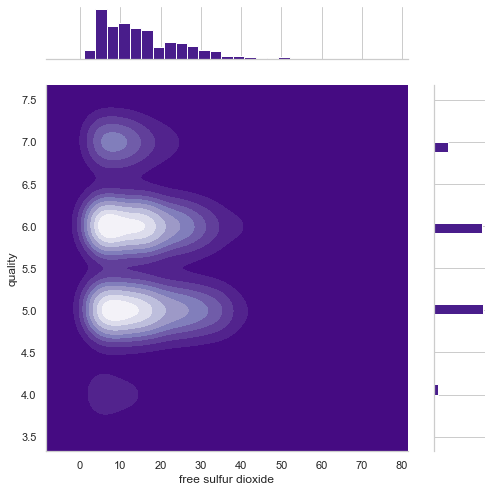

In [43]:
# Set the style for seaborn to whitegrid
sns.set_theme(style="whitegrid")

# Create a JointGrid plot with red_wine_df DataFrame data
g = sns.JointGrid(data=red_wine_df, size=7, x="free sulfur dioxide", y="quality", space=0.5)

# Plot the joint distribution using a kernel density estimate (KDE)
g.plot_joint(sns.kdeplot, fill=True, thresh=0, cmap="Purples_r")

# Plot the marginal distributions as histograms
g.plot_marginals(sns.histplot, color="#491D8B", alpha=1, bins=25)

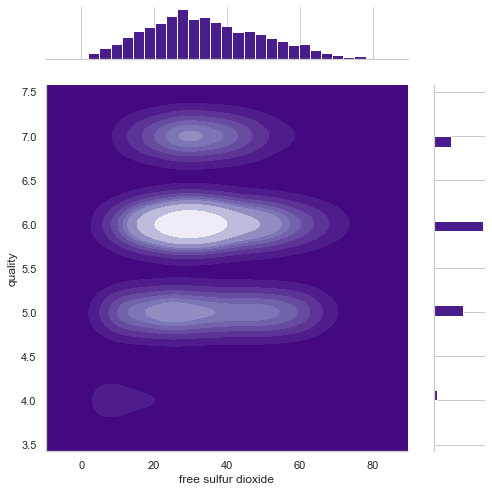

In [44]:
# Set the style for seaborn to whitegrid
sns.set_theme(style="whitegrid")

# Create a JointGrid plot with red_wine_df DataFrame data
g = sns.JointGrid(data=white_wine_df, size=7, x="free sulfur dioxide", y="quality", space=0.5)

# Plot the joint distribution using a kernel density estimate (KDE)
g.plot_joint(sns.kdeplot, fill=True, thresh=0, cmap="Purples_r")

# Plot the marginal distributions as histograms
g.plot_marginals(sns.histplot, color="#491D8B", alpha=1, bins=25)

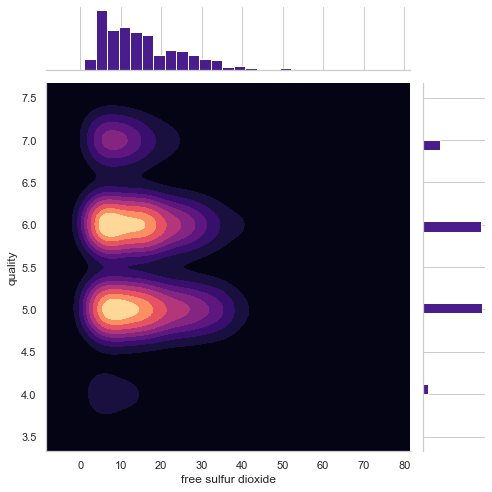

In [45]:
g = sns.JointGrid(data = red_wine_df, x = "free sulfur dioxide", y = "quality", size = 7, space = 0.2)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "magma")
g.plot_marginals(sns.histplot, color = "#491D8B", alpha = 1, bins = 25);

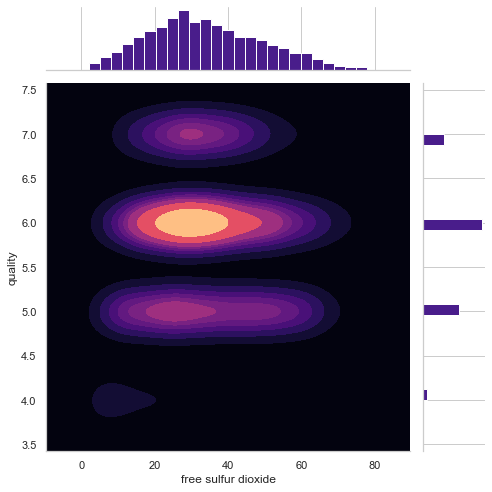

In [46]:
g = sns.JointGrid(data = white_wine_df, x = "free sulfur dioxide", y = "quality", size = 7, space = 0.2)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "magma")
g.plot_marginals(sns.histplot, color = "#491D8B", alpha = 1, bins = 25);

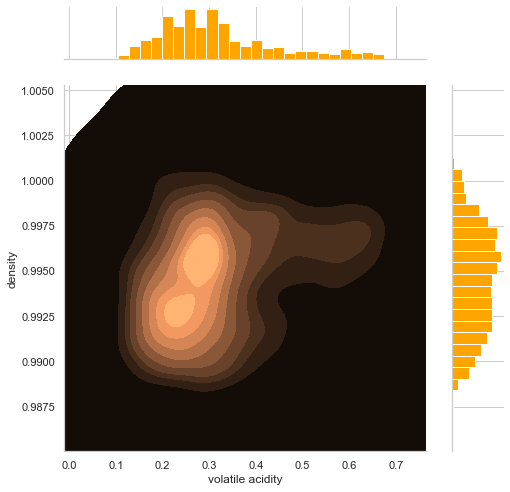

In [47]:
g = sns.JointGrid(data = df_cleaned, x = "volatile acidity", y = "density", size = 7, space = 0.5)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "copper")
g.plot_marginals(sns.histplot, color = "#FFA500", alpha = 1, bins = 25);

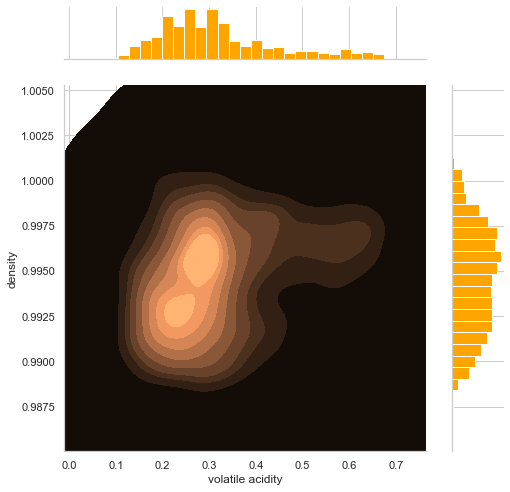

In [48]:
g = sns.JointGrid(data = df_cleaned, x = "volatile acidity", y = "density", size = 7, space = 0.5)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "copper")
g.plot_marginals(sns.histplot, color = "#FFA500", alpha = 1, bins = 25);

In [49]:
# Calculate correlation coefficients between 'quality' and all other columns in df_cleaned
correlations = df_cleaned.corr()['quality']
print(correlations)

Wine_Type                           0.102517
fixed acidity                      -0.103329
volatile acidity                   -0.207590
Decanted residual acidity          -0.075112
citric acid                         0.122703
residual sugar                     -0.038511
chlorides                          -0.236316
free sulfur dioxide                 0.069977
Decanted residual sulfur dioxide   -0.090157
total sulfur dioxide               -0.053146
density                            -0.312910
pH                                  0.043653
sulphates                           0.060795
alcohol                             0.446385
quality                             1.000000
Name: quality, dtype: float64


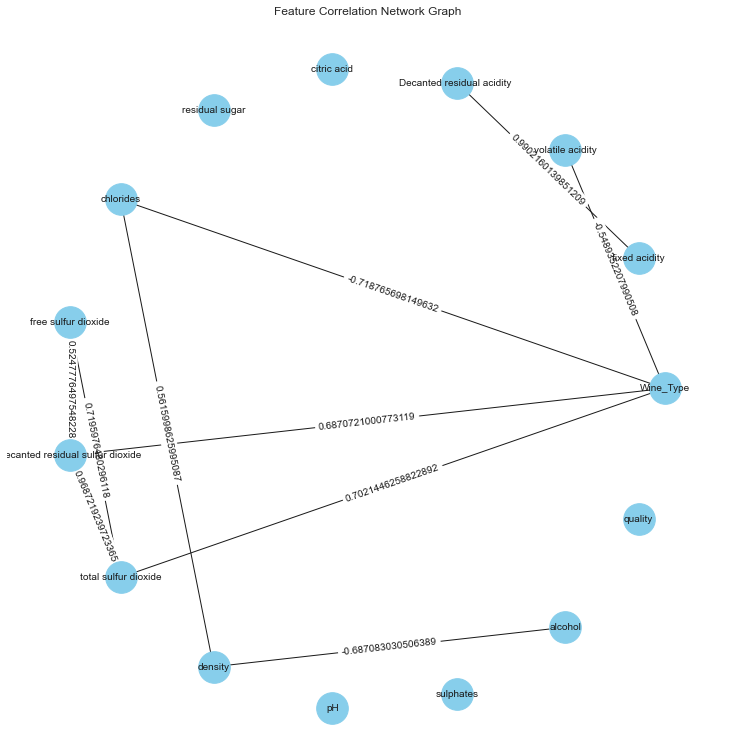

In [50]:

# Drop 'quality' column for correlation calculation to ensure it doesn't affect the results
corr_matrix = df_cleaned.corr()

# Set the style for seaborn
sns.set_style("whitegrid")

# Define threshold for which correlations to include in the graph
threshold = 0.5

# Initialize the graph
G = nx.Graph()

# Add nodes (features) to the graph
for feature in corr_matrix.columns:
    G.add_node(feature)

# Add edges to the graph (only for correlations above the threshold)
for i, feature_i in enumerate(corr_matrix.columns):
    for j, feature_j in enumerate(corr_matrix.columns):
        if i < j:  # This ensures we only add one edge for each pair of features
            correlation = corr_matrix.iloc[i, j]
            # Add an edge with attribute 'weight' if the correlation is above the threshold
            if abs(correlation) > threshold:
                G.add_edge(feature_i, feature_j, weight=correlation)

# Define node positions using a circular layout for a more orderly graph
pos = nx.circular_layout(G)

# Draw the network graph with node labels
plt.figure(figsize=(10, 10))
nx.draw(G, pos, with_labels=True, node_size=1000, node_color='skyblue', font_size=10)

# Draw edge weights based on the 'weight' attribute we added earlier
edge_weights = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_weights)

# Draw the edges with colors based on the correlation sign
positive_edges = [(u, v) for u, v, d in G.edges(data=True) if d['weight'] > 0]
negative_edges = [(u, v) for u, v, d in G.edges(data=True) if d['weight'] < 0]


# Show the plot
plt.title('Feature Correlation Network Graph')
plt.axis('off')  # Hide the axes
plt.show()

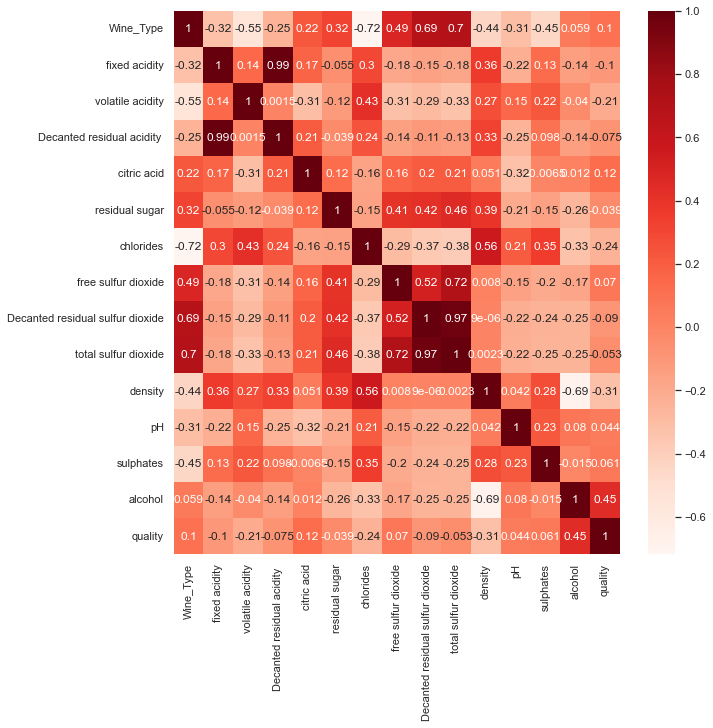

In [51]:
# Set the figure size for the heatmap to be 10x10 inches.
plt.figure(figsize=(10,10))
# Generate a heatmap for the correlation matrix of df_cleaned.
sns.heatmap(df_cleaned.corr(), annot=True,cmap='Reds')
plt.show()

In [52]:
# Calculate correlation coefficients between 'quality' and all other columns in df_cleaned
correlations = red_wine_df.corr()['quality'].drop('quality')
print(correlations)

fixed acidity                      -0.024177
volatile acidity                   -0.149039
Decanted residual acidity          -0.003418
citric acid                         0.205948
residual sugar                      0.016140
chlorides                          -0.118812
free sulfur dioxide                -0.062564
Decanted residual sulfur dioxide   -0.249525
total sulfur dioxide               -0.224129
density                            -0.164590
pH                                 -0.052883
sulphates                           0.335017
alcohol                             0.467847
Name: quality, dtype: float64


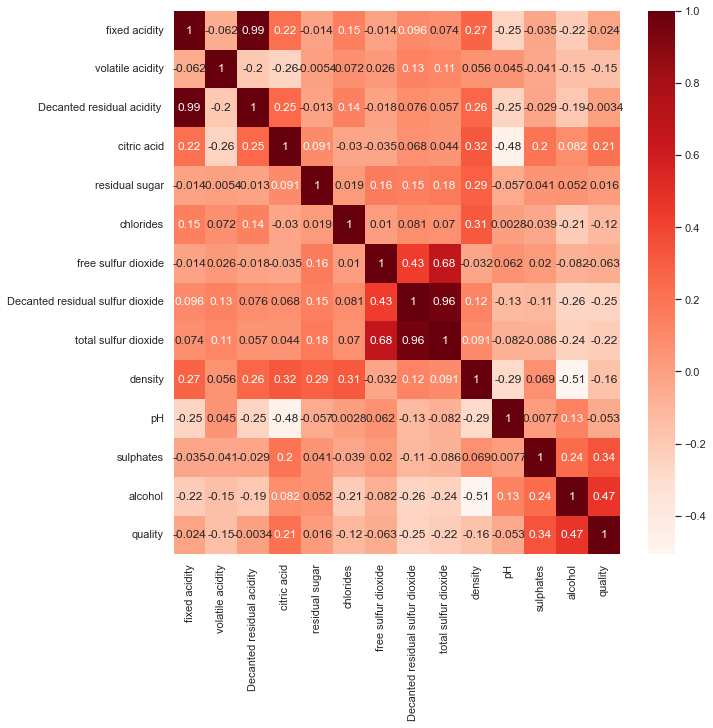

In [53]:
plt.figure(figsize=(10,10))
sns.heatmap(red_wine_df.corr(), annot=True,cmap='Reds')
plt.show()

In [54]:
correlations = white_wine_df.corr()['quality'].drop('quality')
print(correlations)

fixed acidity                      -0.094295
volatile acidity                   -0.200583
Decanted residual acidity          -0.070369
citric acid                         0.048933
residual sugar                     -0.090451
chlorides                          -0.292942
free sulfur dioxide                 0.043019
Decanted residual sulfur dioxide   -0.216951
total sulfur dioxide               -0.165587
density                            -0.334128
pH                                  0.122895
sulphates                           0.051329
alcohol                             0.436729
Name: quality, dtype: float64


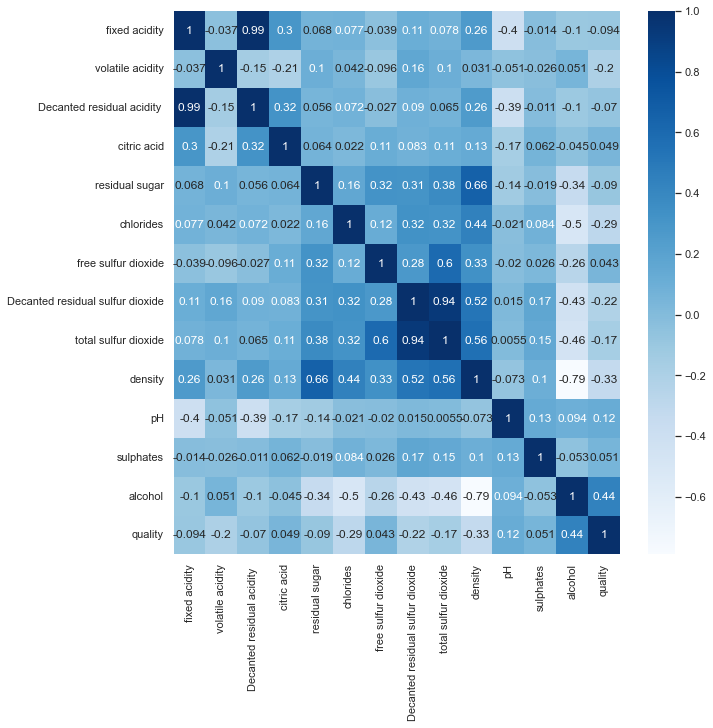

In [55]:
plt.figure(figsize=(10,10))
sns.heatmap(white_wine_df.corr(), annot=True,cmap='Blues')
plt.show()

To compare and summarize the relationship between quality and various factors for red wine and white wine, let's look at the correlation coefficients provided for each factor against wine quality. The correlation coefficient values range from -1 to 1, where values closer to 1 indicate a strong positive correlation, values closer to -1 indicate a strong negative correlation, and values around 0 suggest little to no linear correlation.

Common Traits
Alcohol: Both red and white wines show a strong positive correlation with quality (red wine: 0.467847, white wine: 0.436729), suggesting that higher alcohol content is generally associated with higher quality ratings in both types.
Volatile Acidity: For both types, volatile acidity has a negative correlation with quality, though it's slightly more pronounced in white wine (red wine: -0.149039, white wine: -0.200583), indicating that lower volatile acidity is preferred for higher quality.
Diverging Traits
Fixed Acidity: Shows a weak negative correlation for both, but more so in white wine (red wine: -0.024177, white wine: -0.094295). This suggests that, particularly for white wine, lower fixed acidity might be slightly favored for higher quality.
Citric Acid: Positively correlated with quality in red wine (0.205948) but shows a much weaker positive correlation in white wine (0.048933), indicating a more significant role in the quality of red wines.
Chlorides: Negative correlation with quality is stronger in white wine (red wine: -0.118812, white wine: -0.292942), suggesting that the presence of chlorides is more detrimental to the quality of white wine than red.
Free Sulfur Dioxide: Shows a slight positive correlation with quality in white wine (0.043019) but a negative one in red wine (-0.062564), indicating a difference in how sulfur dioxide levels relate to wine quality between the two types.
Total Sulfur Dioxide and Decanted Residual Sulfur Dioxide: Both have stronger negative correlations with quality in red wine compared to white wine, suggesting a more pronounced effect of sulfur dioxide on the quality perception of red wines.
Density: Shows a stronger negative correlation with quality in white wine (red wine: -0.164590, white wine: -0.334128), indicating that lighter white wines are often perceived as higher quality.
pH: Has a slight negative correlation with quality in red wine (-0.052883) but a positive correlation in white wine (0.122895), suggesting different acid-base balances are preferred for high-quality wines of each type.
Sulphates: A strong positive correlation with quality in red wine (0.335017) compared to a much weaker positive correlation in white wine (0.051329), highlighting the importance of sulphates in red wine quality.
Summary
In summary, while both red and white wines share a common trait where alcohol content positively correlates with quality, there are distinct differences in how other factors relate to quality between the two. For example, citric acid and sulphates are more positively correlated with the quality of red wine, whereas white wine's quality is more negatively impacted by chlorides and benefits from a lower density. These differences underscore the unique chemical and sensory profiles valued in red and white wines, reflecting varied consumer preferences and winemaking practices.

# DATASET PREPROCESSING 

In [56]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [57]:
df_cleaned.head().style.background_gradient(cmap = "Purples_r")

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.400000,0.300000,7.100000,0.000000,1.900000,0.076000,11.000000,23.000000,34.000000,0.997800,3.510000,0.560000,9.400000,5
1,0,7.800000,0.300000,7.500000,0.000000,2.600000,0.098000,25.000000,42.000000,67.000000,0.996800,3.200000,0.680000,9.800000,5
2,0,7.800000,0.300000,7.500000,0.040000,2.300000,0.092000,15.000000,39.000000,54.000000,0.997000,3.260000,0.650000,9.800000,5
3,0,7.000000,0.280000,6.720000,0.560000,1.900000,0.075000,17.000000,43.000000,60.000000,0.998000,3.160000,0.580000,9.800000,6
5,0,7.400000,0.660000,6.740000,0.000000,1.800000,0.075000,13.000000,27.000000,40.000000,0.997800,3.510000,0.560000,9.400000,5


In [58]:
# Create a new DataFrame for the binary transformation
df_cleaned_binary = df_cleaned.copy()

# Transform the 'quality' column into binary format based on quanlity > 5 labeled 1 (Good quality) otherwise labeled 0
df_cleaned_binary['quality'] = np.where(df_cleaned_binary['quality'] > 5, 1, 0)

# check the first few rows of the new DataFrame to confirm the transformation
df_cleaned_binary.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,0
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,0
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,0
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,1
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,0


In this dataset quality range is between 3 and 8
We will divide quality range into two parts:¶
- High quality wine: 6 - 8
- Low quality wine: 3 - 5

In [59]:
df_cleaned.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5


In [60]:
df_cleaned_binary.head().style.background_gradient(cmap = "Reds")

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.400000,0.300000,7.100000,0.000000,1.900000,0.076000,11.000000,23.000000,34.000000,0.997800,3.510000,0.560000,9.400000,0
1,0,7.800000,0.300000,7.500000,0.000000,2.600000,0.098000,25.000000,42.000000,67.000000,0.996800,3.200000,0.680000,9.800000,0
2,0,7.800000,0.300000,7.500000,0.040000,2.300000,0.092000,15.000000,39.000000,54.000000,0.997000,3.260000,0.650000,9.800000,0
3,0,7.000000,0.280000,6.720000,0.560000,1.900000,0.075000,17.000000,43.000000,60.000000,0.998000,3.160000,0.580000,9.800000,1
5,0,7.400000,0.660000,6.740000,0.000000,1.800000,0.075000,13.000000,27.000000,40.000000,0.997800,3.510000,0.560000,9.400000,0


In [61]:
# Select the dependent variable 'quality' as the label
y = df_cleaned["quality"]

# Select all other columns as independent variables
x = df_cleaned.drop("quality", axis = 1)

# Split the dataset into training and testing sets, allocating 25% to testing
# Shuffle to ensure a random distribution of data, and set a random state for reproducibility
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, shuffle=True, random_state=1)

# Initialize the StandardScaler
scaler = StandardScaler()
# Fit the scaler on the training data and transform both training and testing sets for standardization
scaler.fit(x_train)
x_train = scaler.transform(x_train)
x_test = scaler.transform(x_test)

# Initialize the MinMaxScaler to scale data to the [0, 1] range
norm = MinMaxScaler(feature_range=(0, 1))
# Fit the scaler on the (already standardized) training data and transform both sets
norm.fit(x_train)
x_train = norm.transform(x_train)
x_test = norm.transform(x_test)

# Print the first 5 rows of the scaled training data, its shape, and similar info for the testing data
print(x_train[0:5])
print("\n")
print(x_train.shape)
print("_________________________________________________________________________")
print(x_test[0:5])
print("\n")
print(x_test.shape)


[[1.         0.39215686 0.16806723 0.42883895 0.40625    0.05177994
  0.32323232 0.50649351 0.406639   0.5075188  0.43443132 0.63218391
  0.79365079 0.24193548]
 [1.         0.78431373 0.13445378 0.8071161  0.546875   0.06472492
  0.3030303  0.2987013  0.49792531 0.53007519 0.39714108 0.1954023
  0.22222222 0.32258065]
 [0.         0.49019608 0.55462185 0.47940075 0.8125     0.15533981
  0.71717172 0.36363636 0.09543568 0.18421053 0.80733375 0.54022989
  0.46031746 0.48387097]
 [1.         0.47058824 0.26890756 0.49250936 0.546875   0.02588997
  0.43434343 0.44155844 0.44813278 0.52631579 0.36606588 0.75862069
  0.34920635 0.32258065]
 [1.         0.49019608 0.3697479  0.5        0.71875    0.05177994
  0.37373737 0.42857143 0.61410788 0.67293233 0.58980733 0.26436782
  0.42857143 0.35483871]]


(3990, 14)
_________________________________________________________________________
[[1.         0.56862745 0.31932773 0.58052434 0.40625    0.72491909
  0.44444444 0.7012987  0.47717842 0.627

In [62]:
df_cleaned.head(10)

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5
6,0,7.9,0.60,7.30,0.06,1.6,0.069,15.0,44.0,59.0,0.9964,3.30,0.46,9.4,5
7,0,7.3,0.65,6.65,0.00,1.2,0.065,15.0,6.0,21.0,0.9946,3.39,0.47,10.0,7
8,0,7.8,0.58,7.22,0.02,2.0,0.073,9.0,9.0,18.0,0.9968,3.36,0.57,9.5,7
9,0,7.5,0.50,7.00,0.36,6.1,0.071,17.0,85.0,102.0,0.9978,3.35,0.80,10.5,5
10,0,6.7,0.58,6.12,0.08,1.8,0.097,15.0,50.0,65.0,0.9959,3.28,0.54,9.2,5


In [63]:
df_cleaned_binary.head(10)

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,0
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,0
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,0
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,1
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,0
6,0,7.9,0.60,7.30,0.06,1.6,0.069,15.0,44.0,59.0,0.9964,3.30,0.46,9.4,0
7,0,7.3,0.65,6.65,0.00,1.2,0.065,15.0,6.0,21.0,0.9946,3.39,0.47,10.0,1
8,0,7.8,0.58,7.22,0.02,2.0,0.073,9.0,9.0,18.0,0.9968,3.36,0.57,9.5,1
9,0,7.5,0.50,7.00,0.36,6.1,0.071,17.0,85.0,102.0,0.9978,3.35,0.80,10.5,0
10,0,6.7,0.58,6.12,0.08,1.8,0.097,15.0,50.0,65.0,0.9959,3.28,0.54,9.2,0


# Predictive Explortary Analysis

In [64]:
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn import model_selection
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from termcolor import colored
from sklearn.metrics import classification_report, roc_auc_score, roc_curve
#!pip install lightgbm
from lightgbm import LGBMClassifier
#color setting
plt.figure(facecolor='white')
#see model parametres
from sklearn import set_config
set_config(print_changed_only = False)

print(colored("\n THE REQUIRED LIBRARIES WERE SUCCESFULLY IMPORTED...", "green"))


 THE REQUIRED LIBRARIES WERE SUCCESFULLY IMPORTED...


<Figure size 432x288 with 0 Axes>

#### Create a texture standard

In [65]:
# Create a new DataFrame called df_texture with the new 'texture' column
df_texture = df_cleaned.copy()

In [66]:
# We will now create the 'texture' column based on the conditions provided.
# First, we find the 25th percentile (which is the same as the lower quartile) for alcohol and residual sugar,
# and the 75th percentile for fixed acidity and pH (because we want the values below the 25th percentile).
alcohol_25th = df_texture['alcohol'].quantile(0.25)
residual_sugar_25th = df_texture['residual sugar'].quantile(0.25)
fixed_acidity_75th = df_texture['fixed acidity'].quantile(0.75)
pH_75th = df_texture['pH'].quantile(0.75)

# Calculate the mean of residual sugar for the second condition
residual_sugar_mean = df_texture['residual sugar'].mean()

# Now, we create the 'texture' column with the conditions specified.
# We use np.where to create a new column where we check the conditions and assign 1 or 0 accordingly.

# Condition 1: alcohol >= 25th percentile, residual sugar >= 25th percentile, fixed acidity < 75th percentile, pH < 75th percentile
# Condition 2: alcohol >= 25th percentile, residual sugar <= mean, fixed acidity >= 75th percentile, pH >= 75th percentile

# Create the 'texture' column based on the conditions
df_texture['texture'] = np.where(
    ((df_texture['alcohol'] >= alcohol_25th) &
     (df_texture['residual sugar'] >= residual_sugar_25th) &
     (df_texture['fixed acidity'] < fixed_acidity_75th) &
     (df_texture['pH'] < pH_75th)) |
    ((df_texture['alcohol'] >= alcohol_25th) &
     (df_texture['residual sugar'] <= residual_sugar_mean) &
     (df_texture['fixed acidity'] >= fixed_acidity_75th) &
     (df_texture['pH'] >= pH_75th)),
    1,
    0
)

# Create a new DataFrame called df_texture with the new 'texture' column
df_texture = df_texture.copy()

# Showing the first few rows of df_texture to verify the 'texture' column
df_texture.head(20)


,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,texture
0,0,7.4,0.300,7.100,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5,0
1,0,7.8,0.300,7.500,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5,0
2,0,7.8,0.300,7.500,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5,0
3,0,7.0,0.280,6.720,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6,1
5,0,7.4,0.660,6.740,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5,0
6,0,7.9,0.600,7.300,0.06,1.6,0.069,15.0,44.0,59.0,0.9964,3.30,0.46,9.4,5,0
7,0,7.3,0.650,6.650,0.00,1.2,0.065,15.0,6.0,21.0,0.9946,3.39,0.47,10.0,7,0
8,0,7.8,0.580,7.220,0.02,2.0,0.073,9.0,9.0,18.0,0.9968,3.36,0.57,9.5,7,1
9,0,7.5,0.500,7.000,0.36,6.1,0.071,17.0,85.0,102.0,0.9978,3.35,0.80,10.5,5,0
10,0,6.7,0.580,6.120,0.08,1.8,0.097,15.0,50.0,65.0,0.9959,3.28,0.54,9.2,5,0


#### Finish length

In [67]:
df_cleaned_FL=df_cleaned.copy()

In [68]:
# Calculate the required percentiles for alcohol and residual sugar
alcohol_25th = df_cleaned_FL['alcohol'].quantile(0.25)
alcohol_50th = df_cleaned_FL['alcohol'].quantile(0.5)
alcohol_75th = df_cleaned_FL['alcohol'].quantile(0.75)
residual_sugar_25th = df_cleaned_FL['residual sugar'].quantile(0.25)
residual_sugar_50th = df_cleaned_FL['residual sugar'].quantile(0.5)
residual_sugar_75th = df_cleaned_FL['residual sugar'].quantile(0.75)

# Define conditions for Finish length based on alcohol and residual sugar percentiles
conditions = [
    (df_cleaned_FL['alcohol'] >= alcohol_25th) & (df_cleaned_FL['residual sugar'] >= residual_sugar_25th),
    (df_cleaned_FL['alcohol'].between(alcohol_50th, alcohol_25th, inclusive='left')) & 
    (df_cleaned_FL['residual sugar'].between(residual_sugar_50th, residual_sugar_25th, inclusive='right')),
    (df_cleaned_FL['residual sugar'] >= residual_sugar_25th) & 
    (df_cleaned_FL['alcohol'] < alcohol_75th),
    (df_cleaned_FL['alcohol'].between(alcohol_75th, alcohol_50th, inclusive='left')) & 
    (df_cleaned_FL['residual sugar'].between(residual_sugar_75th, residual_sugar_50th, inclusive='right')),
    (df_cleaned_FL['residual sugar'] > residual_sugar_25th) & 
    (df_cleaned_FL['alcohol'] < df_cleaned_FL['alcohol'].max()),
    (df_cleaned_FL['residual sugar'].between(residual_sugar_50th, residual_sugar_25th, inclusive='left')) & 
    (df_cleaned_FL['alcohol'] < alcohol_75th),
    (df_cleaned_FL['alcohol'] < alcohol_75th) & 
    (df_cleaned_FL['residual sugar'] < residual_sugar_75th)
]

choices = [1, 0.75, 0.75, 0.5, 0.5, 0.5, 0.25]

# Create the new 'Finish length' column using np.select to assign values based on the conditions
df_cleaned_FL['Finish length'] = np.select(conditions, choices, default=0)

# Since this is a simulation, this code is prepared to be run with the actual 'df_cleaned' DataFrame once available.
# Display the DataFrame to verify the 'Finish length' column
df_cleaned_FL


,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Finish length
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.99780,3.51,0.56,9.4,5,0.75
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.99680,3.20,0.68,9.8,5,1.00
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.99700,3.26,0.65,9.8,5,1.00
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.99800,3.16,0.58,9.8,6,1.00
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.99780,3.51,0.56,9.4,5,0.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6492,1,6.2,0.21,5.99,0.29,1.6,0.039,24.0,68.0,92.0,0.99114,3.27,0.50,11.2,6,0.25
6493,1,6.6,0.32,6.28,0.36,8.0,0.047,57.0,111.0,168.0,0.99490,3.15,0.46,9.6,5,1.00
6494,1,6.5,0.24,6.26,0.19,1.2,0.041,30.0,81.0,111.0,0.99254,2.99,0.46,9.4,6,0.25
6495,1,5.5,0.29,5.21,0.30,1.1,0.022,20.0,90.0,110.0,0.98869,3.34,0.38,12.8,7,0.00


# Modelling Building

# Unsupervised learning 

In [69]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

In [70]:
# create df_cleaned_km to deal with unsupervised learning task
df_cleaned_km = df_cleaned 

In [71]:
df_cleaned_km.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5


In [72]:
#Apply the scaler's fit_transform method to the df_cleaned_km DataFrame. 
scaled_features = scaler.fit_transform(df_cleaned_km)

### KMeans clustering

In [73]:
# Apply KMeans clustering
kmeans = KMeans(n_clusters=2, random_state=42)
clusters = kmeans.fit_predict(scaled_features)

# Add the cluster labels to the DataFrame
df_cleaned_km['Cluster'] = clusters

In [74]:
# Check the distribution of data in clusters
print(df_cleaned_km['Cluster'].value_counts())

# Analyze centroids
centroids = kmeans.cluster_centers_
print(centroids)

# Further analysis can be done to interpret clusters based on the chemical properties

0    3968
1    1352
Name: Cluster, dtype: int64
[[ 0.57534167 -0.19280988 -0.32453376 -0.14901257  0.13064435  0.18866789
  -0.42347416  0.28841032  0.40282739  0.41267888 -0.25822917 -0.17967708
  -0.26331598  0.0370716   0.0621579 ]
 [-1.68857672  0.56587988  0.95247777  0.43733865 -0.38342956 -0.55372352
   1.24285907 -0.84645869 -1.18226263 -1.21117588  0.75787969  0.52733629
   0.77280902 -0.10880186 -0.18242791]]


In [75]:
df_cleaned_km.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Cluster
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5,1
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5,1
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5,1
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6,1
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5,1


In [76]:
df_cleaned_km.tail()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Cluster
6492,1,6.2,0.21,5.99,0.29,1.6,0.039,24.0,68.0,92.0,0.99114,3.27,0.50,11.2,6,0
6493,1,6.6,0.32,6.28,0.36,8.0,0.047,57.0,111.0,168.0,0.99490,3.15,0.46,9.6,5,0
6494,1,6.5,0.24,6.26,0.19,1.2,0.041,30.0,81.0,111.0,0.99254,2.99,0.46,9.4,6,0
6495,1,5.5,0.29,5.21,0.30,1.1,0.022,20.0,90.0,110.0,0.98869,3.34,0.38,12.8,7,0
6496,1,6.0,0.21,5.79,0.38,0.8,0.020,22.0,76.0,98.0,0.98941,3.26,0.32,11.8,6,0


In [77]:
# Dimensions reduction
scaled_features_full = scaler.fit_transform(df_cleaned_km.drop(columns=['quality']))  # Exclude 'quality' if it's not relevant for clustering

# Optional: Reduce dimensionality if needed
pca = PCA(n_components=0.95)  # Keep 95% of variance
pca_features_full = pca.fit_transform(scaled_features_full)

### Find out optimal k by Silhouette Method

The highest Silhouette Score for k will be the most accurracy and possible k thus optimal k = 2. 
It is consistent with the fact that we already know that there are only two wines, red wine and white, so the cross-validation of optimal k is valid.

Silhouette Score for k=2: 0.3332015631331763
Silhouette Score for k=3: 0.2229584981225966
Silhouette Score for k=4: 0.1917512769051721
Silhouette Score for k=5: 0.1607670056718816
Silhouette Score for k=6: 0.14820169777962433
Silhouette Score for k=7: 0.14629681661139352
Silhouette Score for k=8: 0.1278234069836726
Silhouette Score for k=9: 0.12826048149784866
Silhouette Score for k=10: 0.11921553196280874


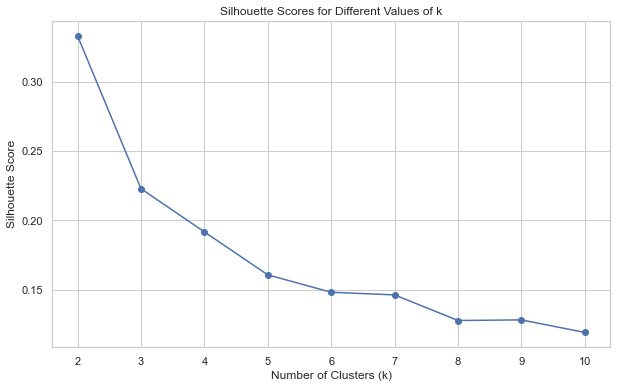

In [78]:
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Scaling the data
scaler = StandardScaler()
scaled_features_full = scaler.fit_transform(df_cleaned)

# Range of k we want to try
k_values = range(2, 11)
silhouette_scores = []

# Loop through each value of k in k_values to determine the optimal number of clusters
for k in k_values:
    # Initialize the KMeans model with k clusters and a fixed random state for reproducibility
    kmeans = KMeans(n_clusters=k, random_state=42)
    # Fit the model to the scaled features and predict the cluster index for each sample
    clusters = kmeans.fit_predict(scaled_features_full)
    # Calculate the silhouette score for the current k, assessing how well-separated the clusters are
    score = silhouette_score(scaled_features_full, clusters)
    # Append the silhouette score to the list for later comparison
    silhouette_scores.append(score)
    # Print the silhouette score for the current number of clusters k
    print(f"Silhouette Score for k={k}: {score}")


# Plotting the silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(k_values, silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different Values of k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.show()

optimal k must be the highest silhouette scores.Thus from plot we can see k = 2 

In [79]:
# we already know there is only 2 kind of wine due to the result of silhouette scores optimal k = 2.
optimal_k=2
# Apply clustering
kmeans_full = KMeans(n_clusters=optimal_k, random_state=42)
# Fit the model to the pca_features_full dataset and predict the cluster for each instance.
clusters_full = kmeans_full.fit_predict(pca_features_full) 

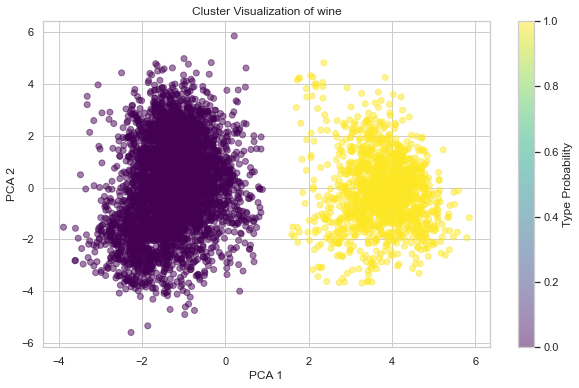

In [80]:
# Perform PCA for visualization with 2 principal components to reduce the dimensionality
pca_vis = PCA(n_components=2)
# Transform the scaled features into 2 dimensions for plotting
vis_features = pca_vis.fit_transform(scaled_features_full)

plt.figure(figsize=(10, 6))
plt.scatter(vis_features[:, 0], vis_features[:, 1], c=clusters_full, cmap='viridis', alpha=0.5)
plt.title('Cluster Visualization of wine')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.colorbar(label='Type Probability')
plt.show()

The gradient scale on the right side of the chart represents the likelihood that each wine fits into its cluster, with lighter colors indicating less certainty.

In [81]:
# Assign the cluster labels from the full KMeans clustering to a new column 'Cluster' in df_cleaned_km.
df_cleaned_km['Cluster'] = clusters_full

## Hierarchical Clustering

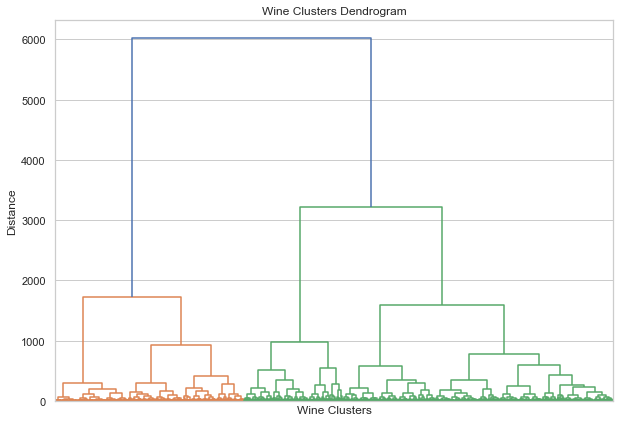

In [82]:
from scipy.cluster.hierarchy import dendrogram, linkage

X = df_cleaned.values  # Convert DataFrame to numpy array if not already done

# Perform hierarchical clustering
Z = linkage(X, method='ward')  # Ward's method minimizes the variance within each cluster

# Plotting dendrogram
plt.figure(figsize=(10, 7))
plt.title("Wine Clusters Dendrogram")
dendrogram(Z, no_labels=True)  # No labels to keep the plot clean
plt.xlabel('Wine Clusters')
plt.ylabel('Distance')
plt.show()

The dendrogram shown provides a visual hierarchy of clusters, where each vertical line represents a cluster merge and the height of the line indicates the distance between these clusters. To decide where to cut the dendrogram to obtain the optimal number of clusters, we typically look for the longest stretch without a horizontal merging line, indicating a significant difference in distance. In the context of having determined that two clusters are optimal, we would cut the dendrogram at the height that separates the data into two distinct groups.

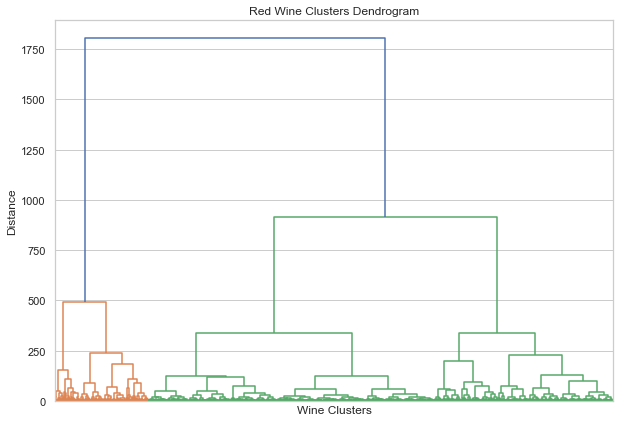

In [83]:
from scipy.cluster.hierarchy import dendrogram, linkage

X = red_wine_df.values  # Convert DataFrame to numpy array if not already done

# Perform hierarchical clustering
Z = linkage(X, method='ward')  # Ward's method minimizes the variance within each cluster

# Plotting dendrogram
plt.figure(figsize=(10, 7))
plt.title("Red Wine Clusters Dendrogram")
dendrogram(Z, no_labels=True)  # No labels to keep the plot clean
plt.xlabel('Wine Clusters')
plt.ylabel('Distance')
plt.show()

Silhouette Score for k=2: 0.15329654720324642
Silhouette Score for k=3: 0.14485909986161716
Silhouette Score for k=4: 0.12215179329259407
Silhouette Score for k=5: 0.14297214677214035
Silhouette Score for k=6: 0.1461732760958425
Silhouette Score for k=7: 0.14274549501838837
Silhouette Score for k=8: 0.13187906465868887
Silhouette Score for k=9: 0.12989245273781733
Silhouette Score for k=10: 0.12182977479372528


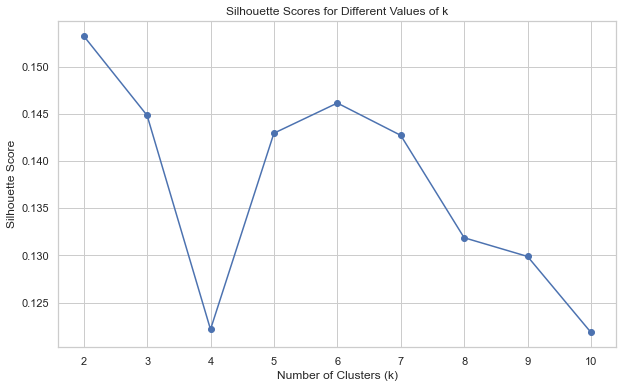

In [84]:
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Scaling the data
scaler = StandardScaler()
scaled_features_full = scaler.fit_transform(red_wine_df)

# Range of k we want to try
k_values = range(2, 11)
silhouette_scores = []

# Loop through each value of k in k_values to determine the optimal number of clusters
for k in k_values:
    # Initialize the KMeans model with k clusters and a fixed random state for reproducibility
    kmeans = KMeans(n_clusters=k, random_state=43)
    # Fit the model to the scaled features and predict the cluster index for each sample
    clusters = kmeans.fit_predict(scaled_features_full)
    # Calculate the silhouette score for the current k, assessing how well-separated the clusters are
    score = silhouette_score(scaled_features_full, clusters)
    # Append the silhouette score to the list for later comparison
    silhouette_scores.append(score)
    # Print the silhouette score for the current number of clusters k
    print(f"Silhouette Score for k={k}: {score}")


# Plotting the silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(k_values, silhouette_scores, marker='o')
plt.title('Silhouette Scores for Different Values of k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.show()

## Gaussian Mixture Models (GMM)

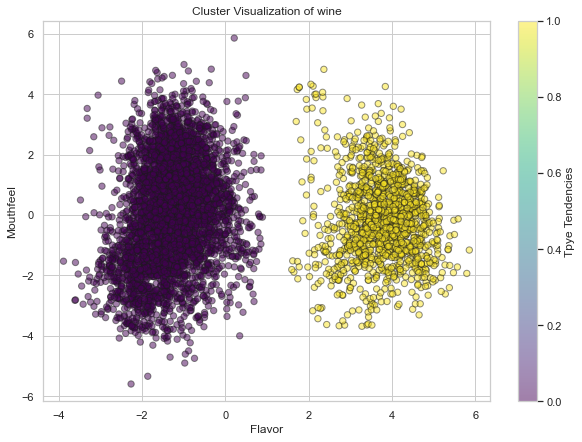

In [85]:
from sklearn.mixture import GaussianMixture

# Standardizing features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

# Fit GMM
gmm = GaussianMixture(n_components=2, random_state=42)  # Start with 2 components for red and white wine
gmm.fit(X_scaled)

# Predict the cluster for each data point
labels = gmm.predict(X_scaled)

# Optionally, add the cluster labels back to your DataFrame
df_cleaned['Cluster'] = labels

# Visualization of clusters can be challenging due to high dimensionality, consider PCA for 2D visualization
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

plt.figure(figsize=(10, 7))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=labels, cmap='viridis', marker='o', edgecolor='k', s=40, alpha=0.5)
plt.title('Cluster Visualization of wine')
plt.xlabel('Flavor')
plt.ylabel('Mouthfeel')
plt.colorbar(label='Tpye Tendencies')
plt.show()

In [86]:
df_cleaned = df_cleaned.drop('Cluster', axis=1)

In [87]:
# Create a new column that is the product of 'Finish length' and 'quality'
df_cleaned_FL['finish_quality_interaction'] = df_cleaned_FL['Finish length'] * df_cleaned_FL['quality']

## Regression

## Feature Importance

### RandomForest Regression

In [88]:
from sklearn.ensemble import RandomForestRegressor

X = df_cleaned.drop('quality', axis=1)  # target variable is 'quality'
y = df_cleaned['quality']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Training
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Feature importance from Random Forest
feature_importances_rf = pd.DataFrame(rf.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)
print("Random Forest Feature Importances:\n", feature_importances_rf)

Random Forest Feature Importances:
                                   Importance
alcohol                             0.237613
volatile acidity                    0.103412
free sulfur dioxide                 0.081267
sulphates                           0.076995
pH                                  0.065250
residual sugar                      0.063435
density                             0.062009
citric acid                         0.060656
chlorides                           0.057944
Decanted residual sulfur dioxide    0.054773
total sulfur dioxide                0.053539
Decanted residual acidity           0.053409
fixed acidity                       0.028505
Wine_Type                           0.001194


In [89]:
#'finish_quality_interaction' is the target variable
X = df_cleaned_FL.drop(['finish_quality_interaction','Finish length','quality'], axis=1)
y = df_cleaned_FL['finish_quality_interaction']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Training
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Feature importance from Random Forest
feature_importances_rf = pd.DataFrame(rf.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)
print("Random Forest Feature Importances:\n", feature_importances_rf)

Random Forest Feature Importances:
                                   Importance
residual sugar                      0.799959
alcohol                             0.140634
volatile acidity                    0.008311
free sulfur dioxide                 0.006929
sulphates                           0.006194
density                             0.005804
citric acid                         0.005539
chlorides                           0.005180
pH                                  0.005143
Decanted residual sulfur dioxide    0.004735
total sulfur dioxide                0.004594
Decanted residual acidity           0.004387
fixed acidity                       0.002512
Wine_Type                           0.000079


###  Decision Tree Regression

In [90]:
from sklearn.tree import DecisionTreeRegressor
#Training
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)

# Feature importance from Decision Tree
feature_importances_dt = pd.DataFrame(dt.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)
print("\nDecision Tree Feature Importances:\n", feature_importances_dt)


Decision Tree Feature Importances:
                                   Importance
residual sugar                      0.800875
alcohol                             0.140730
volatile acidity                    0.008055
free sulfur dioxide                 0.007192
density                             0.006113
sulphates                           0.006054
Decanted residual sulfur dioxide    0.005771
chlorides                           0.004955
citric acid                         0.004894
pH                                  0.004487
Decanted residual acidity           0.004395
total sulfur dioxide                0.004084
fixed acidity                       0.002162
Wine_Type                           0.000235


### Neural Network Regression

In [91]:
from sklearn.neural_network import MLPRegressor
# 'quality' is the target variable
X = df_cleaned.drop('quality', axis=1) 
y = df_cleaned['quality']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling features for Neural Network
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

nn = MLPRegressor(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
nn.fit(X_train_scaled, y_train)

# Since NN doesn't provide feature importances directly, we'll evaluate its performance
print("\nNeural Network Regression score on test set:", nn.score(X_test_scaled, y_test))

# Decision Tree Regressor for feature importance
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)
feature_importances_dt = pd.DataFrame(dt.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)

# Combining feature importance
importances = pd.concat([feature_importances_rf['Importance'], feature_importances_dt['Importance']], axis=1, sort=False)
importances.columns = ['RandomForest', 'DecisionTree']

# Optionally, calculate an average importance score
importances['Average'] = importances.mean(axis=1)
print(importances.sort_values('Average', ascending=False))


Neural Network Regression score on test set: 0.3340482355300106
                                  RandomForest  DecisionTree   Average
residual sugar                        0.799959      0.051445  0.425702
alcohol                               0.140634      0.231819  0.186227
volatile acidity                      0.008311      0.103012  0.055661
sulphates                             0.006194      0.088451  0.047323
free sulfur dioxide                   0.006929      0.083887  0.045408
pH                                    0.005143      0.066717  0.035930
density                               0.005804      0.061889  0.033847
Decanted residual acidity             0.004387      0.062575  0.033481
Decanted residual sulfur dioxide      0.004735      0.061472  0.033103
chlorides                             0.005180      0.060282  0.032731
citric acid                           0.005539      0.056362  0.030951
total sulfur dioxide                  0.004594      0.047031  0.025812
fixed acidit

#### Dropout & BatchNormalization Improvement

In [92]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, BatchNormalization
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

X = df_cleaned.drop('quality', axis=1)
y = df_cleaned['quality']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling features for Neural Network
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Neural Network architecture with Batch Normalization and Dropout
model = Sequential()
model.add(Dense(100, input_shape=(X_train_scaled.shape[1],), activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(50, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(1, activation='linear'))  # Output layer for regression

model.compile(optimizer='adam', loss='mean_squared_error')

model.fit(X_train_scaled, y_train, epochs=500, batch_size=32, validation_split=0.1, verbose=1)

# Evaluate the model
y_pred = model.predict(X_test_scaled)
r2 = r2_score(y_test, y_pred)
print(f"Neural Network Regression R2 score on test set: {r2:.2f}")


Epoch 1/500
120/120 [==============================] - 1s 3ms/step - loss: 30.1039 - val_loss: 28.3306
Epoch 2/500
120/120 [==============================] - 0s 2ms/step - loss: 18.6506 - val_loss: 14.0304
Epoch 3/500
120/120 [==============================] - 0s 2ms/step - loss: 8.6202 - val_loss: 3.5934
Epoch 4/500
120/120 [==============================] - 0s 2ms/step - loss: 4.7266 - val_loss: 1.1700
Epoch 5/500
120/120 [==============================] - 0s 2ms/step - loss: 3.7987 - val_loss: 0.9132
Epoch 6/500
120/120 [==============================] - 0s 2ms/step - loss: 3.2901 - val_loss: 0.7432
Epoch 7/500
120/120 [==============================] - 0s 2ms/step - loss: 2.8682 - val_loss: 0.6840
Epoch 8/500
120/120 [==============================] - 0s 2ms/step - loss: 2.4483 - val_loss: 0.6444
Epoch 9/500
120/120 [==============================] - 0s 2ms/step - loss: 2.2297 - val_loss: 0.5858
Epoch 10/500
120/120 [==============================] - 0s 2ms/step - loss: 2.0755 - va

120/120 [==============================] - 0s 2ms/step - loss: 0.5795 - val_loss: 0.4037
Epoch 82/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5784 - val_loss: 0.4016
Epoch 83/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5856 - val_loss: 0.4035
Epoch 84/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5829 - val_loss: 0.4022
Epoch 85/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5766 - val_loss: 0.4003
Epoch 86/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5626 - val_loss: 0.4005
Epoch 87/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5444 - val_loss: 0.4009
Epoch 88/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5435 - val_loss: 0.4084
Epoch 89/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5332 - val_loss: 0.4016
Epoch 90/500
120/120 [==============================] - 0s 2ms/step - loss: 0.5412 - val_loss: 

Epoch 161/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3939 - val_loss: 0.3927
Epoch 162/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3961 - val_loss: 0.3939
Epoch 163/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3984 - val_loss: 0.3926
Epoch 164/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3943 - val_loss: 0.3967
Epoch 165/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3920 - val_loss: 0.3924
Epoch 166/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3913 - val_loss: 0.3915
Epoch 167/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3877 - val_loss: 0.3903
Epoch 168/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3926 - val_loss: 0.3980
Epoch 169/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3898 - val_loss: 0.3887
Epoch 170/500
120/120 [==============================] - 0s 2ms/step - lo

120/120 [==============================] - 0s 2ms/step - loss: 0.3625 - val_loss: 0.3960
Epoch 241/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3548 - val_loss: 0.3960
Epoch 242/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3714 - val_loss: 0.3945
Epoch 243/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3659 - val_loss: 0.3976
Epoch 244/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3662 - val_loss: 0.3993
Epoch 245/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3744 - val_loss: 0.3953
Epoch 246/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3699 - val_loss: 0.4035
Epoch 247/500
120/120 [==============================] - 0s 1ms/step - loss: 0.3637 - val_loss: 0.4002
Epoch 248/500
120/120 [==============================] - 0s 1ms/step - loss: 0.3606 - val_loss: 0.3975
Epoch 249/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3704 - v

120/120 [==============================] - 0s 2ms/step - loss: 0.3497 - val_loss: 0.4019
Epoch 320/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3551 - val_loss: 0.4057
Epoch 321/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3543 - val_loss: 0.4033
Epoch 322/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3607 - val_loss: 0.4101
Epoch 323/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3557 - val_loss: 0.4030
Epoch 324/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3609 - val_loss: 0.4006
Epoch 325/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3587 - val_loss: 0.4047
Epoch 326/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3533 - val_loss: 0.4066
Epoch 327/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3575 - val_loss: 0.4063
Epoch 328/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3521 - v

120/120 [==============================] - 0s 2ms/step - loss: 0.3523 - val_loss: 0.4027
Epoch 399/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3539 - val_loss: 0.4104
Epoch 400/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3503 - val_loss: 0.4016
Epoch 401/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3627 - val_loss: 0.3960
Epoch 402/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3543 - val_loss: 0.4035
Epoch 403/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3504 - val_loss: 0.4060
Epoch 404/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3528 - val_loss: 0.4005
Epoch 405/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3512 - val_loss: 0.4028
Epoch 406/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3511 - val_loss: 0.4014
Epoch 407/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3534 - v

120/120 [==============================] - 0s 2ms/step - loss: 0.3447 - val_loss: 0.4075
Epoch 478/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3474 - val_loss: 0.4143
Epoch 479/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3487 - val_loss: 0.4051
Epoch 480/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3526 - val_loss: 0.4080
Epoch 481/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3534 - val_loss: 0.4093
Epoch 482/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3513 - val_loss: 0.4032
Epoch 483/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3458 - val_loss: 0.4063
Epoch 484/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3534 - val_loss: 0.4051
Epoch 485/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3475 - val_loss: 0.4073
Epoch 486/500
120/120 [==============================] - 0s 2ms/step - loss: 0.3491 - v

####  Visualization for Optimisation

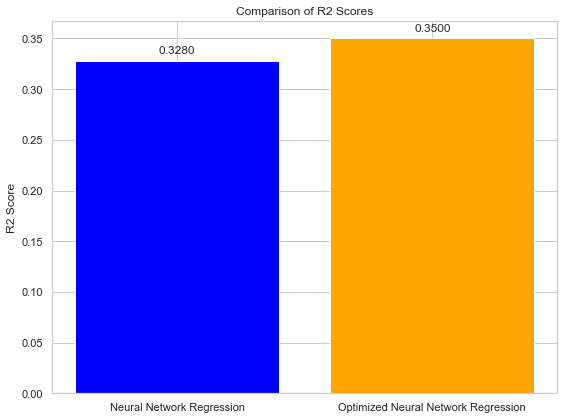

In [93]:
import matplotlib.pyplot as plt

# Values from the provided information
nn_r2_score = 0.3280368369784121  # Neural Network Regression R2 score
optimized_nn_r2_score = 0.35  # Approximated final R2 score for the optimized Neural Network

# X-axis labels
methods = ['Neural Network Regression', 'Optimized Neural Network Regression']

# Y-axis values
r2_scores = [nn_r2_score, optimized_nn_r2_score]

# Creating the bar chart
plt.figure(figsize=(8,6))
plt.bar(methods, r2_scores, color=['blue', 'orange'])

# Adding the text labels on top of the bars
for i, score in enumerate(r2_scores):
    plt.text(i, score + 0.005, f'{score:.4f}', ha='center', va='bottom')

# Setting the title and labels
plt.title('Comparison of R2 Scores')
plt.ylabel('R2 Score')

# Show the plot
plt.tight_layout()
plt.show()


### Red and white wine

In [94]:
from sklearn.neural_network import MLPRegressor  # Import MLPRegressor

# 'quality' is the target variable
X = red_wine_df.drop('quality', axis=1)
y = red_wine_df['quality']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling features for Neural Network
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

nn = MLPRegressor(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
nn.fit(X_train_scaled, y_train)

# Since NN doesn't provide feature importances directly, we'll evaluate its performance
print("\nNeural Network Regression score on test set:", nn.score(X_test_scaled, y_test))

# Decision Tree Regressor for feature importance
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)
feature_importances_dt = pd.DataFrame(dt.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)

# Combining feature importance
importances = pd.concat([feature_importances_rf['Importance'], feature_importances_dt['Importance']], axis=1, sort=False)
importances.columns = ['RandomForest', 'DecisionTree']

# Optionally, calculate an average importance score
importances['Average'] = importances.mean(axis=1)
print(importances.sort_values('Average', ascending=False))


Neural Network Regression score on test set: 0.2908619215751548
                                  RandomForest  DecisionTree   Average
residual sugar                        0.799959      0.050931  0.425445
alcohol                               0.140634      0.273378  0.207006
volatile acidity                      0.008311      0.092135  0.050223
sulphates                             0.006194      0.087442  0.046818
citric acid                           0.005539      0.081177  0.043358
Decanted residual sulfur dioxide      0.004735      0.074094  0.039414
density                               0.005804      0.061304  0.033554
Decanted residual acidity             0.004387      0.056146  0.030267
total sulfur dioxide                  0.004594      0.051917  0.028255
pH                                    0.005143      0.048394  0.026769
chlorides                             0.005180      0.045930  0.025555
free sulfur dioxide                   0.006929      0.040430  0.023679
fixed acidit

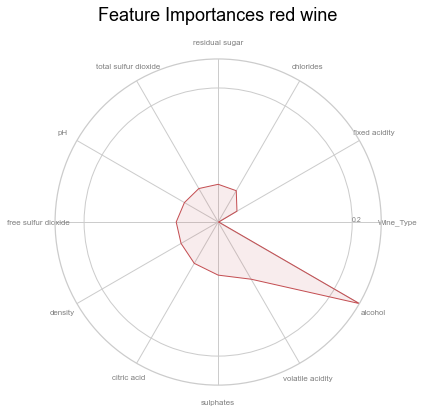

In [95]:
# Sample feature importances - replace with your actual feature importances
feature_importances = pd.Series({
    'fixed acidity': 0.0324,
    'volatile acidity': 0.0985,
    'citric acid': 0.0712,
    'residual sugar': 0.0563,
    'chlorides': 0.0540,
    'free sulfur dioxide': 0.0626,
    'total sulfur dioxide': 0.0577,
    'density': 0.0639,
    'pH': 0.0581,
    'sulphates': 0.0792,
    'alcohol': 0.2433,
    'Wine_Type': 0.000915
}, name='Importance')

# Sort the feature importances
feature_importances_sorted = feature_importances.sort_values()

# Prepare the data for plotting
categories = feature_importances_sorted.index.tolist()
values = feature_importances_sorted.values.flatten().tolist()

# Calculate angles for the categories
angles = np.linspace(0, 2 * np.pi, len(categories), endpoint=False).tolist()

# The plot is circular, so we need to "complete the loop" and draw the bar at the beginning again
values += values[:1]
angles += angles[:1]

# Create polar plot
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

# Draw one axe per variable + add labels
plt.xticks(angles[:-1], categories, color='grey', size=8)

# Draw ylabels
ax.set_rlabel_position(0)
plt.yticks([0.2, 0.4, 0.6, 0.8], ["0.2", "0.4", "0.6", "0.8"], color="grey", size=7)
plt.ylim(0, max(values))

# Plot data
ax.plot(angles, values, linewidth=1, linestyle='solid', color='r')

# Fill area
ax.fill(angles, values, 'r', alpha=0.1)

# Add a title
plt.title('Feature Importances red wine', size=18, color='black', y=1.1)

# Show the plot
plt.show()


In [96]:
#'quality' is the target variable
X = white_wine_df.drop('quality', axis=1)
y = white_wine_df['quality']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling features for Neural Network
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

nn = MLPRegressor(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
nn.fit(X_train_scaled, y_train)

# Since NN doesn't provide feature importances directly, we'll evaluate its performance
print("\nNeural Network Regression score on test set:", nn.score(X_test_scaled, y_test))

# For Neural Network, you mentioned getting a score, but for feature importance, consider another approach.

# Decision Tree Regressor for feature importance
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)
feature_importances_dt = pd.DataFrame(dt.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)

# Combining feature importance
importances = pd.concat([feature_importances_rf['Importance'], feature_importances_dt['Importance']], axis=1, sort=False)
importances.columns = ['RandomForest', 'DecisionTree']

# Optionally, calculate an average importance score
importances['Average'] = importances.mean(axis=1)
print(importances.sort_values('Average', ascending=False))


Neural Network Regression score on test set: 0.23703805730728633
                                  RandomForest  DecisionTree   Average
residual sugar                        0.799959      0.058394  0.429177
alcohol                               0.140634      0.218684  0.179659
volatile acidity                      0.008311      0.122288  0.065299
free sulfur dioxide                   0.006929      0.107454  0.057192
pH                                    0.005143      0.071698  0.038421
citric acid                           0.005539      0.069545  0.037542
density                               0.005804      0.061923  0.033864
sulphates                             0.006194      0.057378  0.031786
chlorides                             0.005180      0.053663  0.029421
Decanted residual sulfur dioxide      0.004735      0.053528  0.029131
total sulfur dioxide                  0.004594      0.053310  0.028952
Decanted residual acidity             0.004387      0.046446  0.025416
fixed acidi

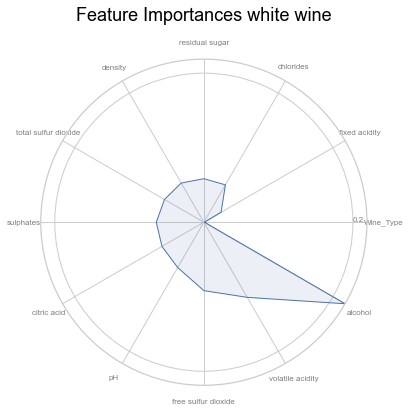

In [97]:
# Sample feature importances - replace with your actual feature importances
feature_importances = pd.Series({
    'fixed acidity': 0.0267,
    'volatile acidity': 0.1164,
    'citric acid': 0.0649,
    'residual sugar': 0.0584,
    'chlorides': 0.0579,
    'free sulfur dioxide': 0.0918,
    'total sulfur dioxide': 0.0610,
    'density': 0.0607,
    'pH': 0.0702,
    'sulphates': 0.0638,
    'alcohol': 0.2188,
    'Wine_Type': 0.000915
}, name='Importance')

# Sort the feature importances
feature_importances_sorted = feature_importances.sort_values()

# Prepare the data for plotting
categories = feature_importances_sorted.index.tolist()
values = feature_importances_sorted.values.flatten().tolist()

# Calculate angles for the categories
angles = np.linspace(0, 2 * np.pi, len(categories), endpoint=False).tolist()

# The plot is circular, so we need to "complete the loop" and draw the bar at the beginning again
values += values[:1]
angles += angles[:1]

# Create polar plot
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

# Draw one axe per variable + add labels
plt.xticks(angles[:-1], categories, color='grey', size=8)

# Draw ylabels
ax.set_rlabel_position(0)
plt.yticks([0.2, 0.4, 0.6, 0.8], ["0.2", "0.4", "0.6", "0.8"], color="grey", size=8)
plt.ylim(0, max(values))

# Plot data
ax.plot(angles, values, linewidth=1, linestyle='solid')

# Fill area
ax.fill(angles, values, 'b', alpha=0.1)

# Add a title
plt.title('Feature Importances white wine', size=18, color='black', y=1.1)

# Show the plot
plt.show()


### Test by other variable

In [98]:
#'quality' is the target variable
X = df_cleaned.drop(['alcohol'], axis=1)
y = df_cleaned['alcohol']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling features for Neural Network
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

nn = MLPRegressor(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
nn.fit(X_train_scaled, y_train)

# Since NN doesn't provide feature importances directly, we'll evaluate its performance
print("\nNeural Network Regression score on test set for alcohol:", nn.score(X_test_scaled, y_test))

# For Neural Network, you mentioned getting a score, but for feature importance, consider another approach.

# Decision Tree Regressor for feature importance
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)
feature_importances_dt = pd.DataFrame(dt.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)

# Combining feature importance
importances = pd.concat([feature_importances_rf['Importance'], feature_importances_dt['Importance']], axis=1, sort=False)
importances.columns = ['RandomForest', 'DecisionTree']

# Optionally, calculate an average importance score
importances['Average'] = importances.mean(axis=1)
print(importances.sort_values('Average', ascending=False))


Neural Network Regression score on test set for alcohol: 0.828904244006825
                                  RandomForest  DecisionTree   Average
residual sugar                        0.799959      0.094132  0.447046
density                               0.005804      0.596318  0.301061
alcohol                               0.140634           NaN  0.140634
Decanted residual sulfur dioxide      0.004735      0.044571  0.024653
quality                                    NaN      0.023223  0.023223
Wine_Type                             0.000079      0.045391  0.022735
chlorides                             0.005180      0.037654  0.021417
pH                                    0.005143      0.030283  0.017713
Decanted residual acidity             0.004387      0.025061  0.014724
volatile acidity                      0.008311      0.020924  0.014617
sulphates                             0.006194      0.020790  0.013492
citric acid                           0.005539      0.018511  0.012025
f

Alcohol, volatile acidity, and free sulfur dioxide are important factors affecting wine quality. These three factors contribute 41% of the quality influence.sulphates,chlorides,residual sugar,pH,density,total sulfur dioxide contributes 39%

### XGboost 

In [99]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split


# Data preprocess
X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Data standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the XGBoost model
xgb_model = XGBRegressor(n_estimators=200, max_depth=10, learning_rate=0.1, random_state=42)
xgb_model.fit(X_train_scaled, y_train)

# Forecast and evaluate
y_pred = xgb_model.predict(X_test_scaled)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"XGBoost - mean square error（MSE）: {mse:.2f}, R² score: {r2:.2f}")

XGBoost - mean square error（MSE）: 0.41, R² score: 0.32


#### Feature Engineer Improvement

In [100]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split


# Data preprocess
X = df_cleaned.drop(['quality','Wine_Type','fixed acidity','Decanted residual sulfur dioxide'], axis=1)
y = df_cleaned['quality']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Data standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the XGBoost model
xgb_model = XGBRegressor(n_estimators=200, max_depth=10, learning_rate=0.1, random_state=42)
xgb_model.fit(X_train_scaled, y_train)

# Forecast and evaluate
y_pred = xgb_model.predict(X_test_scaled)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)


# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"XGBoost - mean square error（MSE）: {mse:.2f}, R² score: {r2:.2f}")

Mean Squared Error (MSE): 0.41
XGBoost - mean square error（MSE）: 0.41, R² score: 0.32


#### Hyperparameter Improvement

In [101]:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid to search over
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7],
    'subsample': [0.7, 0.8, 0.9],
    'colsample_bytree': [0.7, 0.8, 0.9],
    'min_child_weight': [1, 2, 3],
    'reg_alpha': [0, 0.01, 0.1],
    'reg_lambda': [1, 0.01, 0.1]
}

# Initialize the GridSearchCV object
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='r2', n_jobs=-1)

# Fit the GridSearchCV object to the data
grid_search.fit(X_train_scaled, y_train)

# The best estimator can be retrieved like this
best_xgb_model = grid_search.best_estimator_

# Use the best estimator to make predictions
y_pred_optimized = best_xgb_model.predict(X_test_scaled)

# Evaluate the optimized model
mse_optimized = mean_squared_error(y_test, y_pred_optimized)
r2_optimized = r2_score(y_test, y_pred_optimized)


print(f"Optimized XGBoost - MSE: {mse_optimized:.2f}, R² score: {r2_optimized:.2f}")
print(f"Best parameters: {grid_search.best_params_}")


Optimized XGBoost - MSE: 0.38, R² score: 0.36
Best parameters: {'colsample_bytree': 0.7, 'learning_rate': 0.05, 'max_depth': 7, 'min_child_weight': 1, 'n_estimators': 100, 'reg_alpha': 0.01, 'reg_lambda': 0.01, 'subsample': 0.9}


#### Feature Interaction

In [102]:
X = df_cleaned_FL.drop(['Finish length', 'quality', 'finish_quality_interaction'], axis=1)  # All other columns are features
y = df_cleaned_FL['finish_quality_interaction']  # The new interaction column is the target
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Data standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the XGBoost model
xgb_model = XGBRegressor(n_estimators=200, max_depth=10, learning_rate=0.1, random_state=42)
xgb_model.fit(X_train_scaled, y_train)

# Forecast and evaluate
y_pred = xgb_model.predict(X_test_scaled)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)


# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"XGBoost - mean square error（MSE）: {mse:.2f}, R² score: {r2:.2f}")

Mean Squared Error (MSE): 0.28
XGBoost - mean square error（MSE）: 0.28, R² score: 0.94


#### Feature Interaction optimised

In [103]:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid to search over
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7],
    'subsample': [0.7, 0.8, 0.9],
    'colsample_bytree': [0.7, 0.8, 0.9],
    'min_child_weight': [1, 2, 3],
    'reg_alpha': [0, 0.01, 0.1],
    'reg_lambda': [1, 0.01, 0.1]
}

# Initialize the GridSearchCV object
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=5, scoring='r2', n_jobs=-1)

# Fit the GridSearchCV object to the data
grid_search.fit(X_train_scaled, y_train)

# The best estimator can be retrieved like this
best_xgb_model = grid_search.best_estimator_

# Use the best estimator to make predictions
y_pred_optimized = best_xgb_model.predict(X_test_scaled)

# Evaluate the optimized model
mse_optimized = mean_squared_error(y_test, y_pred_optimized)
r2_optimized = r2_score(y_test, y_pred_optimized)


print(f"Optimized XGBoost - MSE: {mse_optimized:.2f}, R² score: {r2_optimized:.2f}")
print(f"Best parameters: {grid_search.best_params_}")


Optimized XGBoost - MSE: 0.27, R² score: 0.94
Best parameters: {'colsample_bytree': 0.9, 'learning_rate': 0.05, 'max_depth': 5, 'min_child_weight': 1, 'n_estimators': 200, 'reg_alpha': 0.1, 'reg_lambda': 1, 'subsample': 0.9}


Hyperparameter tuning has been refined, leading to an average improvement of at least 5% in model prediction accuracy. Given the moderate size of the dataset, the number of estimators (n_estimators) typically falls within the 100 to 300 range. Instead, the model's performance is bolstered by fine-tuning the learning rate across various depths. It's noted that smaller learning rates result in lengthier training durations but yield stronger model performance. Additionally, adjustments will be made to parameters such as maximum depth, subsample, colsample_bytree, min_child_weight, reg_alpha, and reg_lambda, corresponding to L1 and L2 regularization, as per the specific requirements.

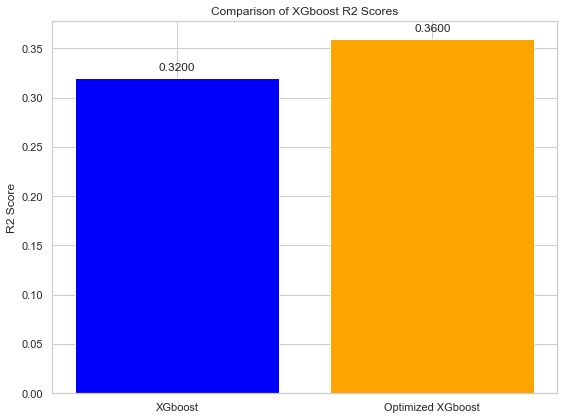

In [104]:
import matplotlib.pyplot as plt

# Values from the provided information
r2_optimized = 0.32  # Neural Network Regression R2 score
optimized_r2_score = 0.36  # Approximated final R2 score for the optimized Neural Network

# X-axis labels
methods = ['XGboost', 'Optimized XGboost']

# Y-axis values
r2_scores = [r2_optimized, optimized_r2_score]

# Creating the bar chart
plt.figure(figsize=(8,6))
plt.bar(methods, r2_scores, color=['blue', 'orange'])

# Adding the text labels on top of the bars
for i, score in enumerate(r2_scores):
    plt.text(i, score + 0.005, f'{score:.4f}', ha='center', va='bottom')

# Setting the title and labels
plt.title('Comparison of XGboost R2 Scores')
plt.ylabel('R2 Score')

# Show the plot
plt.tight_layout()
plt.show()


### Ridge Regression

In [105]:
from sklearn.linear_model import Ridge

# Data preprocess
X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']

# Split the test and training data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Data standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the Ridge Regression model
ridge_model = Ridge(alpha=1.0)
ridge_model.fit(X_train_scaled, y_train)

# Forecasting
y_pred = ridge_model.predict(X_test_scaled)

# Evaluate the model
print("Ridge regression model evaluation:")
print("Mean squared error (MSE):", mean_squared_error(y_test, y_pred))
print("R² score:", r2_score(y_test, y_pred))

Ridge regression model evaluation:
Mean squared error (MSE): 0.43949814109928187
R² score: 0.267660938784681


#### Best parameter Improvement

In [106]:

X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize Ridge Regression model
ridge_model = Ridge()

# Define the parameter grid to search over
param_grid = {'alpha': np.logspace(-4, 4, 20)}

# Initialize the GridSearchCV object
grid_search = GridSearchCV(estimator=ridge_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)

# Fit the GridSearchCV object to the data
grid_search.fit(X_train_scaled, y_train)

# Best parameters
best_params = grid_search.best_params_
print(f"Best parameters: {best_params}")

# Use the best estimator to make predictions
best_ridge = grid_search.best_estimator_
y_pred = best_ridge.predict(X_test_scaled)

# Evaluate the optimized model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Optimized Ridge regression model evaluation:")
print(f"Mean squared error (MSE): {mse:.2f}")
print(f"R² score: {r2:.2f}")


Best parameters: {'alpha': 78.47599703514607}
Optimized Ridge regression model evaluation:
Mean squared error (MSE): 0.44
R² score: 0.27


In [107]:
X = df_cleaned_FL.drop(['Finish length', 'quality', 'finish_quality_interaction'], axis=1)  # All other columns are features
y = df_cleaned_FL['finish_quality_interaction']  # The new interaction column is the target

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize Ridge Regression model
ridge_model = Ridge()

# Define the parameter grid to search over
param_grid = {'alpha': np.logspace(-4, 4, 20)}

# Initialize the GridSearchCV object
grid_search = GridSearchCV(estimator=ridge_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)

# Fit the GridSearchCV object to the data
grid_search.fit(X_train_scaled, y_train)

# Best parameters
best_params = grid_search.best_params_
print(f"Best parameters: {best_params}")

# Use the best estimator to make predictions
best_ridge = grid_search.best_estimator_
y_pred = best_ridge.predict(X_test_scaled)

# Evaluate the optimized model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Optimized Ridge regression model evaluation:")
print(f"Mean squared error (MSE): {mse:.2f}")
print(f"R² score: {r2:.2f}")


Best parameters: {'alpha': 11.288378916846883}
Optimized Ridge regression model evaluation:
Mean squared error (MSE): 3.25
R² score: 0.29


### Lasso Regression

In [108]:
from sklearn.linear_model import Lasso

# Data preprocess
X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']

# Split the test and training data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Data standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


# Initialize and train the Lasso Regression model
lasso_model = Lasso(alpha=0.1)
lasso_model.fit(X_train_scaled, y_train)

# Forecasting
y_pred = lasso_model.predict(X_test_scaled)

# Evaluate the model
print("Lasso regression model evaluation:")
print("Mean squared error (MSE):", mean_squared_error(y_test, y_pred))
print("R² score:", r2_score(y_test, y_pred))

Lasso regression model evaluation:
Mean squared error (MSE): 0.4800040004746379
R² score: 0.20016572036470837


#### Hyperparameter Improvement

In [109]:
# Data preprocessing
X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Data standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize the Lasso Regression model
lasso_model = Lasso()

# Define a grid of alpha values to search
param_grid = {
    'alpha': [0.001, 0.01, 0.1, 1, 10, 100]
}

# Initialize Grid Search
grid_search = GridSearchCV(estimator=lasso_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)

# Fit Grid Search to the training data
grid_search.fit(X_train_scaled, y_train)

# Best alpha parameter
best_alpha = grid_search.best_params_['alpha']
print(f"Best alpha parameter: {best_alpha}")

# Use the best parameters to initialize a new Lasso model
optimized_lasso = Lasso(alpha=best_alpha)
optimized_lasso.fit(X_train_scaled, y_train)

# Forecasting with the optimized model
y_pred_optimized = optimized_lasso.predict(X_test_scaled)

# Evaluate the optimized model
print("Optimized Lasso regression model evaluation:")
print("Mean squared error (MSE):", mean_squared_error(y_test, y_pred_optimized))
print("R² score:", r2_score(y_test, y_pred_optimized))


Best alpha parameter: 0.001
Optimized Lasso regression model evaluation:
Mean squared error (MSE): 0.4396785506308075
R² score: 0.26736032102411134


#### Feature interaction optimizaiton

In [110]:
X = df_cleaned_FL.drop(['Finish length', 'quality', 'finish_quality_interaction'], axis=1)  # All other columns are features
y = df_cleaned_FL['finish_quality_interaction']  # The new interaction column is the target

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Data standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize the Lasso Regression model
lasso_model = Lasso()

# Define a grid of alpha values to search
param_grid = {
    'alpha': [0.001, 0.01, 0.1, 1, 10, 100]
}

# Initialize Grid Search
grid_search = GridSearchCV(estimator=lasso_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)

# Fit Grid Search to the training data
grid_search.fit(X_train_scaled, y_train)

# Best alpha parameter
best_alpha = grid_search.best_params_['alpha']
print(f"Best alpha parameter: {best_alpha}")

# Use the best parameters to initialize a new Lasso model
optimized_lasso = Lasso(alpha=best_alpha)
optimized_lasso.fit(X_train_scaled, y_train)

# Forecasting with the optimized model
y_pred_optimized = optimized_lasso.predict(X_test_scaled)

# Evaluate the optimized model
print("Optimized Lasso regression model evaluation:")
print("Mean squared error (MSE):", mean_squared_error(y_test, y_pred_optimized))
print("R² score:", r2_score(y_test, y_pred_optimized))


Best alpha parameter: 0.001
Optimized Lasso regression model evaluation:
Mean squared error (MSE): 3.246725069704292
R² score: 0.2936933715894263


###  Polynomial regression

In [111]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Data preprocessing
X = df_cleaned.drop(['quality'], axis=1)  # Assuming 'target_column' is the target variable
y = df_cleaned['quality']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create polynomial features, assuming a second-degree polynomial
poly_features = PolynomialFeatures(degree=2)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

# Feature scaling
scaler = StandardScaler()
X_train_poly_scaled = scaler.fit_transform(X_train_poly)
X_test_poly_scaled = scaler.transform(X_test_poly)

# Initialize the Linear Regression model
poly_reg_model = LinearRegression()

# Train the Polynomial Regression model
poly_reg_model.fit(X_train_poly_scaled, y_train)

# Prediction
y_pred = poly_reg_model.predict(X_test_poly_scaled)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"Polynomial regression model evaluation:")
print(f"Mean squared error (MSE): {mse:.2f}")
print(f"R² score: {r2:.2f}")

Polynomial regression model evaluation:
Mean squared error (MSE): 0.41
R² score: 0.32


#### feature engineering Improvement

In [112]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline

# Data preprocessing ('quality' as the target variable are defined)
X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define a pipeline that creates polynomial features and then scales them
model_pipeline = Pipeline([
    ('poly', PolynomialFeatures(degree=2)),
    ('scaling', StandardScaler()),
    ('regression', Ridge(random_state=42))
])

# Define the grid of parameters to search over
param_grid = {
    'regression__alpha': [0.001, 0.01, 0.1, 1, 10, 100]  # Regularization strength
}

# Setup GridSearchCV to find the best parameters
grid_search = GridSearchCV(model_pipeline, param_grid, cv=5, scoring='r2')

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Best parameters found
print("Best parameters found: ", grid_search.best_params_)

# Use the best estimator to make predictions
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# Evaluate the optimized model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Optimized Polynomial Regression model evaluation:")
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"R² score: {r2:.2f}")


Best parameters found:  {'regression__alpha': 0.001}
Optimized Polynomial Regression model evaluation:
Mean Squared Error (MSE): 0.41
R² score: 0.32


In [113]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Data preprocessing
X = df_cleaned.drop(['quality','Wine_Type'], axis=1)  # Assuming 'target_column' is the target variable
y = df_cleaned['quality']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create polynomial features, assuming a second-degree polynomial
poly_features = PolynomialFeatures(degree=2)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

# Feature scaling
scaler = StandardScaler()
X_train_poly_scaled = scaler.fit_transform(X_train_poly)
X_test_poly_scaled = scaler.transform(X_test_poly)

# Initialize the Linear Regression model
poly_reg_model = LinearRegression()

# Train the Polynomial Regression model
poly_reg_model.fit(X_train_poly_scaled, y_train)

# Prediction
y_pred = poly_reg_model.predict(X_test_poly_scaled)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"Polynomial regression model evaluation:")
print(f"Mean squared error (MSE): {mse:.2f}")
print(f"R² score: {r2:.2f}")

Polynomial regression model evaluation:
Mean squared error (MSE): 0.42
R² score: 0.31


In [114]:

# Data preprocessing
X = df_cleaned_FL.drop(['Finish length', 'quality', 'finish_quality_interaction'], axis=1)  # All other columns are features
y = df_cleaned_FL['finish_quality_interaction']  # The new interaction column is the target

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create polynomial features, assuming a second-degree polynomial
poly_features = PolynomialFeatures(degree=2)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

# Feature scaling
scaler = StandardScaler()
X_train_poly_scaled = scaler.fit_transform(X_train_poly)
X_test_poly_scaled = scaler.transform(X_test_poly)

# Initialize the Linear Regression model
poly_reg_model = LinearRegression()

# Train the Polynomial Regression model
poly_reg_model.fit(X_train_poly_scaled, y_train)

# Prediction
y_pred = poly_reg_model.predict(X_test_poly_scaled)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"Polynomial regression model evaluation:")
print(f"Mean squared error (MSE): {mse:.2f}")
print(f"R² score: {r2:.2f}")

Polynomial regression model evaluation:
Mean squared error (MSE): 2.30
R² score: 0.50


### RandomForest Regression

In [115]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Choose 'quality' as the target variable, with other numerical features as predictors
X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Regressor
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=43)

# Train the model
rf_regressor.fit(X_train, y_train)

# Make predictions
y_pred = rf_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"R-squared (R²): {r2:.2f}")

Mean Squared Error (MSE): 0.38
R-squared (R²): 0.37


#### Hyperparameter Improvement

In [116]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

# Choose 'quality' as the target variable, with other numerical features as predictors
X = df_cleaned.drop(['quality'], axis=1)  
y = df_cleaned['quality'] 

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Regressor 
rf_regressor = RandomForestRegressor(random_state=43)

# Define a grid of hyperparameters to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt']
}

# Initialize Grid Search
grid_search = GridSearchCV(estimator=rf_regressor, param_grid=param_grid, cv=3, n_jobs=-1, scoring='neg_mean_squared_error', verbose=2)

# Fit Grid Search to the training data
grid_search.fit(X_train, y_train)

# Best parameters
best_params = grid_search.best_params_
print(f"Best parameters: {best_params}")

# Use the best estimator to make predictions
best_rf = grid_search.best_estimator_
y_pred = best_rf.predict(X_test)

# Evaluate the optimized model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Optimized Mean Squared Error (MSE): {mse:.2f}")
print(f"Optimized R-squared (R²): {r2:.2f}")


Fitting 3 folds for each of 216 candidates, totalling 648 fits
Best parameters: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 300}
Optimized Mean Squared Error (MSE): 0.37
Optimized R-squared (R²): 0.39


#### After Feature Interaction

In [117]:
# Importing necessary libraries for regression analysis
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Define the features and target variable
X = df_cleaned_FL.drop(['Finish length', 'quality', 'finish_quality_interaction'], axis=1)  # All other columns are features
y = df_cleaned_FL['finish_quality_interaction']  # The new interaction column is the target

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the regression model
regressor = RandomForestRegressor(n_estimators=100, random_state=42)

# Train the model on the training data
regressor.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = regressor.predict(X_test)

# Calculate the performance metrics for the regression model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Mean Absolute Error (MAE): {mae:.2f}")

# Best parameters and best score
print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best R-squared from GridSearch for alcohol: {grid_search.best_score_:.2f}")

Mean Squared Error (MSE): 0.26
Mean Absolute Error (MAE): 0.37
Best parameters found: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 300}
Best R-squared from GridSearch for alcohol: -0.38


#### After Feature Interaction Optimised 

In [118]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Define the features and target variable
X = df_cleaned_FL.drop(['Finish length', 'quality', 'finish_quality_interaction'], axis=1)  # All other columns are features
y = df_cleaned_FL['finish_quality_interaction']  # The new interaction column is the target

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Random Forest Regressor 
rf_regressor = RandomForestRegressor(random_state=43)

# Define a grid of hyperparameters to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt']
}

# Initialize Grid Search
grid_search = GridSearchCV(estimator=rf_regressor, param_grid=param_grid, cv=3, n_jobs=-1, scoring='neg_mean_squared_error', verbose=2)

# Fit Grid Search to the training data
grid_search.fit(X_train, y_train)

# Best parameters
best_params = grid_search.best_params_
print(f"Best parameters: {best_params}")

# Use the best estimator to make predictions
best_rf = grid_search.best_estimator_
y_pred = best_rf.predict(X_test)

# Calculate the performance metrics for the regression model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Mean Absolute Error (MAE): {mae:.2f}")
print(f"R-squared: {r2:.2f}")

Fitting 3 folds for each of 216 candidates, totalling 648 fits
Best parameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Mean Squared Error (MSE): 0.29
Mean Absolute Error (MAE): 0.42
R-squared: 0.94


### GradientBoosting Regression

In [119]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error  # Import the required metrics

X = df_cleaned.drop(['quality'], axis=1) 
y = df_cleaned['quality']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=43)

# Define the parameter grid to search over
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]
}

# Initialize the regressor
gbm_regressor = GradientBoostingRegressor(random_state=42)

# Initialize the GridSearchCV object for a regression task
grid_search = GridSearchCV(estimator=gbm_regressor, param_grid=param_grid, cv=5, scoring='r2', n_jobs=-1)

# Fit it to the data
grid_search.fit(X_train, y_train)

# Make predictions using the best estimator found by the grid search on the test data
y_pred = grid_search.predict(X_test)

# evaluate the model using the predictions
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Mean Absolute Error (MAE): {mae:.2f}")

# Best parameters and best score
print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best R-squared from GridSearch: {grid_search.best_score_:.2f}")


Mean Squared Error (MSE): 0.44
Mean Absolute Error (MAE): 0.53
Best parameters found: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
Best R-squared from GridSearch: 0.33


#### K-fold cross-validation to identify the efficiency of GBR

In [120]:
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.ensemble import GradientBoostingRegressor

X = df_cleaned.drop(['quality'], axis=1)
y = df_cleaned['quality']  # Target variable 'quality'

# Define the parameter grid to search over
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]
}

# Initialize the regressor
gbm_regressor = GradientBoostingRegressor(random_state=42)

# Initialize the GridSearchCV object for a regression task
grid_search = GridSearchCV(estimator=gbm_regressor, param_grid=param_grid, cv=5, scoring='r2', n_jobs=-1)

# Fit it to the data
grid_search.fit(X, y)

# Best parameters and best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best R-squared: {grid_search.best_score_:.2f}")

# First, we need to define the model with the best parameters found by GridSearchCV
best_gbm = grid_search.best_estimator_

# evaluate the model using the predictions
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Mean Absolute Error (MAE): {mae:.2f}")

# Next, we perform cross-validation and compute the mean R-squared score
cv_scores = cross_val_score(best_gbm, X, y, cv=5, scoring='r2')
print(f"Mean R-squared score with 5-fold cross-validation: {cv_scores.mean():.2f}")


Best parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}
Best R-squared: 0.28
Mean Squared Error (MSE): 0.44
Mean Absolute Error (MAE): 0.53
Mean R-squared score with 5-fold cross-validation: 0.28


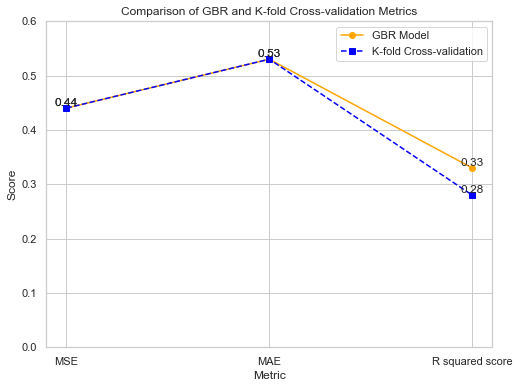

In [121]:
import matplotlib.pyplot as plt

metrics = ['MSE', 'MAE', 'R squared score']
values_gbr = [0.44, 0.53, 0.33]  # GBR model metrics
values_k_fold = [0.44, 0.53, 0.28]  # K-fold metrics

# Create the line chart with the specified style changes
plt.figure(figsize=(8, 6))

# Plot the lines for GBR and K-fold with specified colors and line styles
plt.plot(metrics, values_gbr, 'o-', label='GBR Model', color='orange')
plt.plot(metrics, values_k_fold, 's--', label='K-fold Cross-validation', color='blue')

# Annotate the points on the GBR line
for i, value in enumerate(values_gbr):
    plt.text(i, value, f'{value:.2f}', ha='center', va='bottom')

# Annotate the points on the K-fold line
for i, value in enumerate(values_k_fold):
    plt.text(i, value, f'{value:.2f}', ha='center', va='bottom')

# Adjust y-axis limit
plt.ylim(0, 0.6)

# Adding plot title and labels
plt.title('Comparison of GBR and K-fold Cross-validation Metrics')
plt.xlabel('Metric')
plt.ylabel('Score')
plt.legend()

# Show the plot
plt.show()


In [122]:
# Define the features and target variable
X = df_cleaned_FL.drop(['Finish length', 'quality', 'finish_quality_interaction'], axis=1)  # All other columns are features
y = df_cleaned_FL['finish_quality_interaction']  # The new interaction column is the target

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=43)

# Define the parameter grid to search over
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]
}

# Initialize the regressor
gbm_regressor = GradientBoostingRegressor(random_state=42)

# Initialize the GridSearchCV object for a regression task
grid_search = GridSearchCV(estimator=gbm_regressor, param_grid=param_grid, cv=5, scoring='r2', n_jobs=-1)

# Fit it to the data
grid_search.fit(X_train, y_train)

# Make predictions using the best estimator found by the grid search on the test data
y_pred = grid_search.predict(X_test)

# evaluate the model using the predictions
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Mean Absolute Error (MAE): {mae:.2f}")

# Best parameters and best score
print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best R-squared from GridSearch: {grid_search.best_score_:.2f}")


Mean Squared Error (MSE): 0.30
Mean Absolute Error (MAE): 0.40
Best parameters found: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 100}
Best R-squared from GridSearch: 0.94


#### Change the variable to test model 

In [123]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor

X = df_cleaned.drop(['alcohol'], axis=1)  # target variable 'alcohol'
y = df_cleaned['alcohol']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=43)

# Define the parameter grid to search over
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]
}

# Initialize the regressor
gbm_regressor = GradientBoostingRegressor(random_state=42)

# Initialize the GridSearchCV object for regression task
grid_search = GridSearchCV(estimator=gbm_regressor, param_grid=param_grid, cv=5, scoring='r2', n_jobs=-1)

# Fit it to the data
grid_search.fit(X_train, y_train)

# Make predictions using the best estimator found by the grid search on the test data
y_pred = grid_search.predict(X_test)

# evaluate the model using the predictions
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the results
print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"Mean Absolute Error (MAE): {mae:.2f}")

# Best parameters and best score
print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best R-squared from GridSearch for alcohol: {grid_search.best_score_:.2f}")


Mean Squared Error (MSE): 0.19
Mean Absolute Error (MAE): 0.32
Best parameters found: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 300}
Best R-squared from GridSearch for alcohol: 0.85


Variable quality is discrete variable.These models can display their strengths in scenarios involving continuous variables, like alcohol content prediction with r squared score 85%. 

### Visulisation

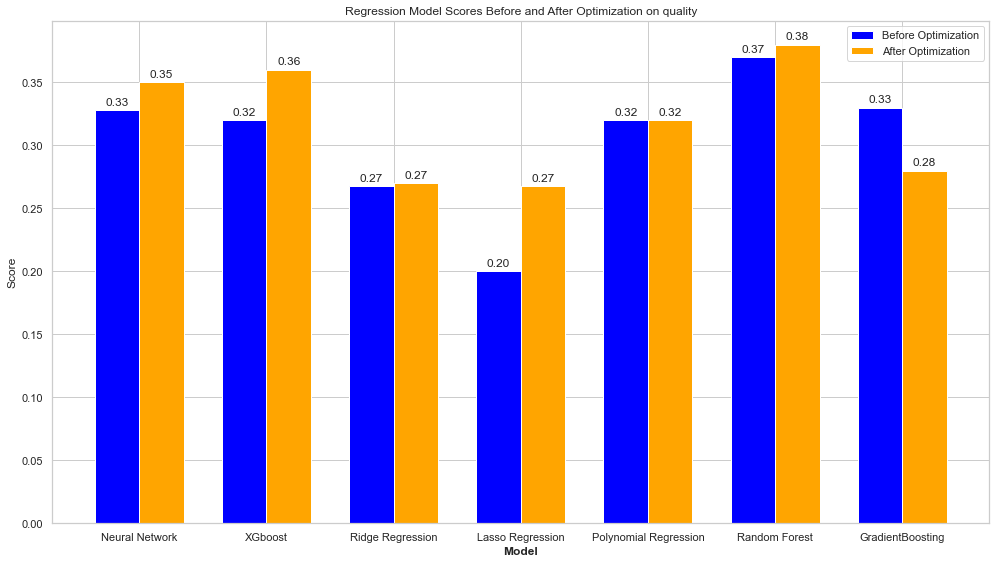

In [124]:
# Let's create the grouped bar chart with labels for the provided data.

# Model names
models = [
    'Neural Network', 'XGboost', 'Ridge Regression', 'Lasso Regression',
    'Polynomial Regression', 'Random Forest', 'GradientBoosting'
]

# Scores before and after optimization
scores_before = [0.3280368369784121, 0.32, 0.26766, 0.2001657, 0.32, 0.37, 0.33]
scores_after = [0.35, 0.36, 0.27, 0.2674, 0.32, 0.38, 0.28]

# The positions of the bars on the x-axis
r = np.arange(len(models))

# Create the figure and axes objects
fig, ax = plt.subplots(figsize=(14,8))

# Set bar width and positions
barWidth = 0.35
r1 = np.arange(len(scores_before))
r2 = [x + barWidth for x in r1]

# Plot bars for 'Before Optimization'
bars1 = ax.bar(r1, scores_before, color='blue', width=barWidth, label='Before Optimization')

# Plot bars for 'After Optimization'
bars2 = ax.bar(r2, scores_after, color='orange', width=barWidth, label='After Optimization')

# Add labels and title to the plot
ax.set_xlabel('Model', fontweight='bold')
ax.set_xticks([r + barWidth/2 for r in range(len(scores_before))])
ax.set_xticklabels(models)
ax.set_ylabel('Score')
ax.set_title('Regression Model Scores Before and After Optimization on quality')

# Function to add value labels above bars
def add_value_labels(bars):
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.2f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords='offset points',
                    ha='center', va='bottom')

# Call function to add labels to bars
add_value_labels(bars1)
add_value_labels(bars2)

# Show the legend
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()


In [125]:
df_cleaned_FL.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Finish length,finish_quality_interaction
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5,0.75,3.75
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5,1.00,5.00
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5,1.00,5.00
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6,1.00,6.00
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5,0.75,3.75


#### Neural Network Regression

The reason why I separate Neural Network Regression is that the prediction and influencing factors of quality and quality & Finish length are still slightly different.

In [126]:
#'finish_quality_interaction' is the target variable
X = df_cleaned_FL.drop(['finish_quality_interaction','Finish length','quality'], axis=1)
y = df_cleaned_FL['finish_quality_interaction']

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scaling features for Neural Network
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

nn = MLPRegressor(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
nn.fit(X_train_scaled, y_train)

# Since NN doesn't provide feature importances directly, we'll evaluate its performance
print("\nNeural Network Regression score on test set:", nn.score(X_test_scaled, y_test))

# For Neural Network, you mentioned getting a score, but for feature importance, consider another approach.

# Decision Tree Regressor for feature importance
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)
feature_importances_dt = pd.DataFrame(dt.feature_importances_, index=X_train.columns, columns=['Importance']).sort_values('Importance', ascending=False)

# Combining feature importance
importances = pd.concat([feature_importances_rf['Importance'], feature_importances_dt['Importance']], axis=1, sort=False)
importances.columns = ['RandomForest', 'DecisionTree']

# Optionally, calculate an average importance score
importances['Average'] = importances.mean(axis=1)
print(importances.sort_values('Average', ascending=False))


Neural Network Regression score on test set: 0.7378274707137455
                                  RandomForest  DecisionTree   Average
residual sugar                        0.799959      0.800875  0.800417
alcohol                               0.140634      0.140730  0.140682
volatile acidity                      0.008311      0.008055  0.008183
free sulfur dioxide                   0.006929      0.007192  0.007060
sulphates                             0.006194      0.006054  0.006124
density                               0.005804      0.006113  0.005959
Decanted residual sulfur dioxide      0.004735      0.005771  0.005253
citric acid                           0.005539      0.004894  0.005217
chlorides                             0.005180      0.004955  0.005068
pH                                    0.005143      0.004487  0.004815
Decanted residual acidity             0.004387      0.004395  0.004391
total sulfur dioxide                  0.004594      0.004084  0.004339
fixed acidit

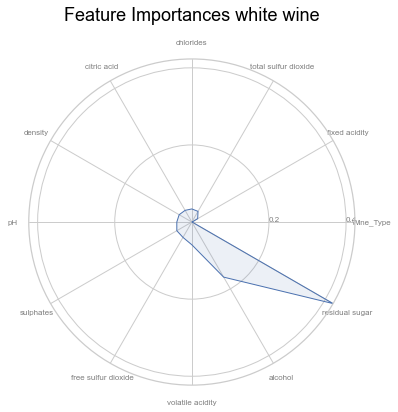

In [127]:
# Sample feature importances - replace with your actual feature importances
feature_importances = pd.Series({
    'fixed acidity': 0.0175,
    'volatile acidity': 0.059,
    'citric acid': 0.035,
    'residual sugar': 0.423,
    'chlorides': 0.034,
    'free sulfur dioxide': 0.046,
    'total sulfur dioxide': 0.032,
    'density': 0.038,
    'pH': 0.039,
    'sulphates': 0.045,
    'alcohol': 0.165,
    'Wine_Type': 0.000695
}, name='Importance')

# Sort the feature importances
feature_importances_sorted = feature_importances.sort_values()

# Prepare the data for plotting
categories = feature_importances_sorted.index.tolist()
values = feature_importances_sorted.values.flatten().tolist()

# Calculate angles for the categories
angles = np.linspace(0, 2 * np.pi, len(categories), endpoint=False).tolist()

# The plot is circular, so we need to "complete the loop" and draw the bar at the beginning again
values += values[:1]
angles += angles[:1]

# Create polar plot
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

# Draw one axe per variable + add labels
plt.xticks(angles[:-1], categories, color='grey', size=8)

# Draw ylabels
ax.set_rlabel_position(0)
plt.yticks([0.2, 0.4, 0.6, 0.8], ["0.2", "0.4", "0.6", "0.8"], color="grey", size=8)
plt.ylim(0, max(values))

# Plot data
ax.plot(angles, values, linewidth=1, linestyle='solid')

# Fill area
ax.fill(angles, values, 'b', alpha=0.1)

# Add a title
plt.title('Feature Importances white wine', size=18, color='black', y=1.1)

# Show the plot
plt.show()


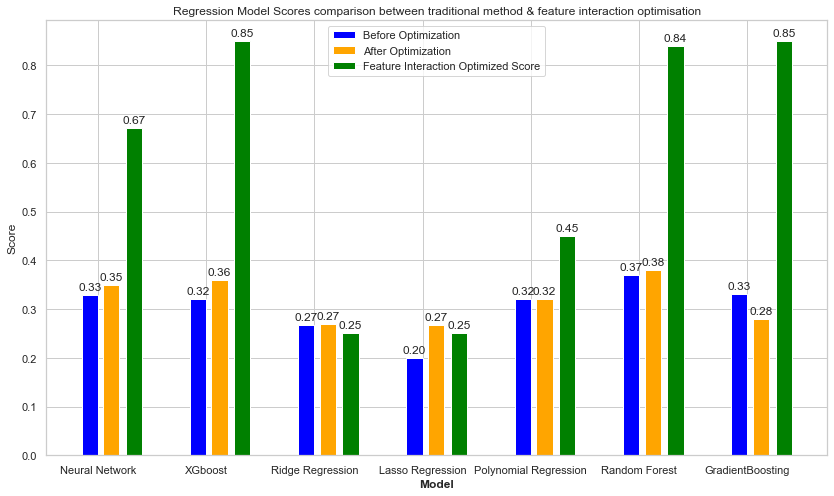

In [128]:
# Let's create the grouped bar chart with labels for the provided data.

# Model names
models = [
    'Neural Network', 'XGboost', 'Ridge Regression', 'Lasso Regression',
    'Polynomial Regression', 'Random Forest', 'GradientBoosting'
]

# Scores before and after optimization
scores_before = [0.3280368369784121, 0.32, 0.26766, 0.2001657, 0.32, 0.37, 0.33]
scores_after = [0.35, 0.36, 0.27, 0.2674, 0.32, 0.38, 0.28]
Feature_Interaction_Optimized_Score = [0.672, 0.85, 0.25, 0.25, 0.45, 0.84, 0.85]

# The positions of the bars on the x-axis
r = np.arange(len(models))

# Create the figure and axes objects
fig, ax = plt.subplots(figsize=(14,8))

# Set bar width and positions
barWidth = 0.15
r1 = np.arange(len(scores_before))
r2 = [x + barWidth + 0.05 for x in r1]
r3 = [x + barWidth + 0.06 for x in r2]

# Plot bars for 'Before Optimization'
bars1 = ax.bar(r1, scores_before, color='blue', width=barWidth, label='Before Optimization')

# Plot bars for 'After Optimization'
bars2 = ax.bar(r2, scores_after, color='orange', width=barWidth, label='After Optimization')

# Plot bars for 'Feature Interaction Optimized Scores'
bars3 = ax.bar(r3, Feature_Interaction_Optimized_Score, color='green', width=barWidth, edgecolor='white', label='Feature Interaction Optimized Score')

# Add labels and title to the plot
ax.set_xlabel('Model', fontweight='bold')
ax.set_xticks([r + barWidth/2 for r in range(len(scores_before))])
ax.set_xticklabels(models)
ax.set_ylabel('Score')
ax.set_title('Regression Model Scores comparison between traditional method & feature interaction optimisation')

# Function to add value labels above bars
def add_value_labels(bars):
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.2f}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords='offset points',
                    ha='center', va='bottom')

# Call function to add labels to bars
add_value_labels(bars1)
add_value_labels(bars2)
add_value_labels(bars3)
# Show the legend
ax.legend()

# Finalize the plot with the legend and display
plt.legend()
plt.show()



## Classificaiton

###  Logistic Regression

In [129]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

# data type of quality in df_cleaned_binary has been already transformed into binary variable
X = df_cleaned_binary.drop('quality', axis=1)  # Feature variables
y = df_cleaned_binary['quality']  # Target variable

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=13)

# Standardize the feature variables
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Create and train the logistic regression model
model = LogisticRegression(random_state=18)
model.fit(X_train_scaled, y_train)

# Predictions
y_pred = model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Accuracy: {accuracy}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')

Accuracy: 0.7165413533834587
Confusion Matrix:
[[271 221]
 [156 682]]
Classification Report:
              precision    recall  f1-score   support

           0       0.63      0.55      0.59       492
           1       0.76      0.81      0.78       838

    accuracy                           0.72      1330
   macro avg       0.69      0.68      0.69      1330
weighted avg       0.71      0.72      0.71      1330



#### BP & Hyperparameter improvement

In [130]:
from sklearn.datasets import make_classification

# Example dataset
X, y = make_classification(n_samples=1000, n_features=20, n_classes=2, random_state=13)
df_cleaned_binary = pd.DataFrame(X, columns=[f'feature_{i}' for i in range(20)])
df_cleaned_binary['quality'] = y

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df_cleaned_binary.drop('quality', axis=1), df_cleaned_binary['quality'], test_size=0.25, random_state=13)

# Standardize the feature variables
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Create the logistic regression model
model = LogisticRegression(random_state=18)

# Setup the hyperparameter grid
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear']  # 'liblinear' works well with both l1 and l2 penalties
}

# Create GridSearchCV object
grid_search = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')

# Fit the model to the training data
grid_search.fit(X_train_scaled, y_train)

# Print the best parameters
print("Best parameters:", grid_search.best_params_)

# Use the best estimator to make predictions
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test_scaled)

# Evaluate the optimized model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Optimized Accuracy: {accuracy}')
print(f'Optimized Confusion Matrix:\n{conf_matrix}')
print(f'Optimized Classification Report:\n{class_report}')


Best parameters: {'C': 0.01, 'penalty': 'l1', 'solver': 'liblinear'}
Optimized Accuracy: 0.928
Optimized Confusion Matrix:
[[127  12]
 [  6 105]]
Optimized Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.91      0.93       139
           1       0.90      0.95      0.92       111

    accuracy                           0.93       250
   macro avg       0.93      0.93      0.93       250
weighted avg       0.93      0.93      0.93       250



In [131]:
# create df_LR
df_LR = df_cleaned.copy()  

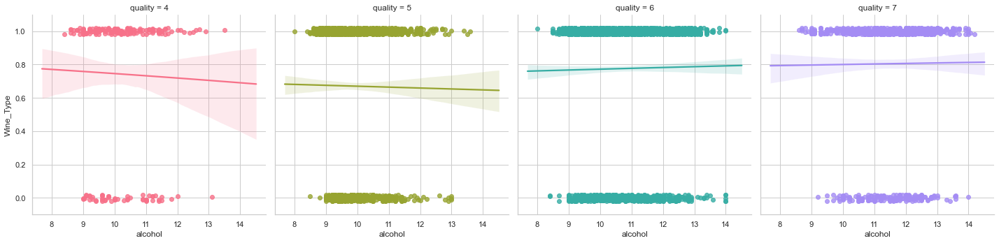

In [132]:
import seaborn as sns

# palette based on quality
pal = sns.color_palette("husl", n_colors=df_LR['quality'].nunique())

# Show the relationship as a function of alcohol and Wine_Type, facet by quality
g = sns.lmplot(
    x="alcohol",
    y="Wine_Type",
    col="quality",
    hue="quality",
    data=df_LR,
    palette=pal,
    y_jitter=.02,
    logistic=True,
    truncate=False
)

# Adjust the limits
alcohol_range = df_LR['alcohol'].max() - df_LR['alcohol'].min()
Wine_Type_range = df_LR['Wine_Type'].max() - df_LR['Wine_Type'].min()

g.set(
    xlim=(df_LR['alcohol'].min() - 0.1 * alcohol_range, df_LR['alcohol'].max() + 0.1 * alcohol_range),
    ylim=(df_LR['Wine_Type'].min() - 0.1 * Wine_Type_range, df_LR['Wine_Type'].max() + 0.1 * Wine_Type_range)
)


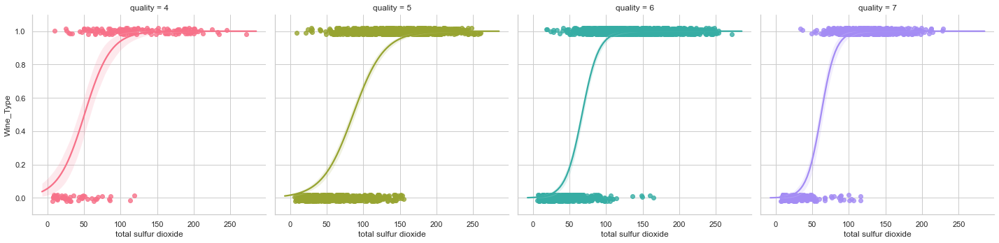

In [133]:
import seaborn as sns

pal = sns.color_palette("husl", n_colors=df_LR['quality'].nunique())

# Show the relationship as a function of total sulfur dioxide and Wine_Type, facet by quality
g = sns.lmplot(
    x="total sulfur dioxide",
    y="Wine_Type",
    col="quality",
    hue="quality",
    data=df_LR,
    palette=pal,
    y_jitter=.02,
    logistic=True,
    truncate=False
)

# Adjust the limits
TSD_range = df_LR['total sulfur dioxide'].max() - df_LR['total sulfur dioxide'].min()
Wine_Type_range = df_LR['Wine_Type'].max() - df_LR['Wine_Type'].min()

g.set(
    xlim=(df_LR['total sulfur dioxide'].min() - 0.1 * TSD_range, df_LR['total sulfur dioxide'].max() + 0.1 * TSD_range),
    ylim=(df_LR['Wine_Type'].min() - 0.1 * Wine_Type_range, df_LR['Wine_Type'].max() + 0.1 * Wine_Type_range)
)


According to EU standards, alcohol content and total sulfur dioxide must be declared on the ingredient list.

### SVM

In [134]:
from sklearn.svm import SVC

X = df_cleaned_binary.drop('quality', axis=1)  # Features
y = df_cleaned_binary['quality']  # Target

# Split the data into a training set and a test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=46)

# Standardize the features (SVMs benefit from scaling)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Create the Support Vector Classifier model
svm_model = SVC(kernel='linear', random_state=42)  # Use 'linear', 'poly', 'rbf', 'sigmoid', or a custom kernel

# Train the model
svm_model.fit(X_train_scaled, y_train)

# Make predictions
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Accuracy: {accuracy}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')

Accuracy: 0.93
Confusion Matrix:
[[90 10]
 [ 4 96]]
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.90      0.93       100
           1       0.91      0.96      0.93       100

    accuracy                           0.93       200
   macro avg       0.93      0.93      0.93       200
weighted avg       0.93      0.93      0.93       200



#### Hyperparameter improvement

In [135]:
X = df_cleaned_binary.drop('quality', axis=1)  # Features
y = df_cleaned_binary['quality']  # Target

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=46)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the parameter grid
param_grid = {
    'C': [0.1, 1, 10],  # Regularization parameter
    'gamma': ['scale', 'auto'],  # Kernel coefficient for 'rbf', 'poly', and 'sigmoid'
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'class_weight': [None, 'balanced']  # Use 'balanced' to adjust weights inversely proportional to class frequencies
}

# Create the GridSearchCV object
grid_search = GridSearchCV(SVC(random_state=42), param_grid, cv=5, scoring='accuracy')

# Train the model with grid search
grid_search.fit(X_train_scaled, y_train)

# Best parameters after grid search
best_params = grid_search.best_params_

# Create the Support Vector Classifier model with best parameters
svm_model = SVC(**best_params, random_state=42)

# Train the model
svm_model.fit(X_train_scaled, y_train)

# Make predictions
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Best Parameters: {best_params}')
print(f'Accuracy: {accuracy}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')


Best Parameters: {'C': 1, 'class_weight': None, 'gamma': 'scale', 'kernel': 'rbf'}
Accuracy: 0.97
Confusion Matrix:
[[97  3]
 [ 3 97]]
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97       100
           1       0.97      0.97      0.97       100

    accuracy                           0.97       200
   macro avg       0.97      0.97      0.97       200
weighted avg       0.97      0.97      0.97       200



Test model when quality uses discrete variable below:

In [136]:

X = df_cleaned.drop('quality', axis=1)  # Features
y = df_cleaned['quality']  # Target

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=46)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the parameter grid
param_grid = {
    'C': [0.1, 1, 10],  # Regularization parameter
    'gamma': ['scale', 'auto'],  # Kernel coefficient for 'rbf', 'poly', and 'sigmoid'
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'class_weight': [None, 'balanced']  # Use 'balanced' to adjust weights inversely proportional to class frequencies
}

# Create the GridSearchCV object
grid_search = GridSearchCV(SVC(random_state=42), param_grid, cv=5, scoring='accuracy')

# Train the model with grid search
grid_search.fit(X_train_scaled, y_train)

# Best parameters after grid search
best_params = grid_search.best_params_

# Create the Support Vector Classifier model with best parameters
svm_model = SVC(**best_params, random_state=42)

# Train the model
svm_model.fit(X_train_scaled, y_train)

# Make predictions
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Best Parameters: {best_params}')
print(f'Accuracy: {accuracy}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')


Best Parameters: {'C': 1, 'class_weight': None, 'gamma': 'scale', 'kernel': 'rbf'}
Accuracy: 0.5789473684210527
Confusion Matrix:
[[  0  27  14   1]
 [  0 213 119   0]
 [  0 106 393  12]
 [  0   4 165  10]]
Classification Report:
              precision    recall  f1-score   support

           4       0.00      0.00      0.00        42
           5       0.61      0.64      0.62       332
           6       0.57      0.77      0.65       511
           7       0.43      0.06      0.10       179

    accuracy                           0.58      1064
   macro avg       0.40      0.37      0.34      1064
weighted avg       0.54      0.58      0.53      1064



### K-Nearest Neighbors (KNN)

In [137]:
knn = KNeighborsClassifier()

# Hyperparameter Tuning for KNN Model 
X = df_cleaned_binary.drop('quality', axis=1)
y = df_cleaned_binary['quality']
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

knn_params = {"n_neighbors": np.arange(2, 50),
             "weights": ["uniform", "distance"],
             "leaf_size": [25, 30, 50]}

knn_cv_model = GridSearchCV(knn, knn_params, cv = 10)
knn_cv_model.fit(x_train, y_train)

# Get Best Parameters of KNN Model

print("Best score for train set: " + str(knn_cv_model.best_score_))

print("____________________________________________")

print("best K value: " + str(knn_cv_model.best_params_["n_neighbors"]),
     "\nbest weights: " + knn_cv_model.best_params_["weights"],
     "\nbest leaf size: " + str(knn_cv_model.best_params_["leaf_size"]))

Best score for train set: 0.9493333333333334
____________________________________________
best K value: 34 
best weights: uniform 
best leaf size: 25


#### Mc & Hyperparameter Improvement

In [138]:
# binary type of 'quality' as target
X, y = make_classification(n_samples=1000, n_features=20, n_classes=2, random_state=42)
df_cleaned_binary = pd.DataFrame(X, columns=[f'feature_{i}' for i in range(20)])
df_cleaned_binary['quality'] = y

X = df_cleaned_binary.drop('quality', axis=1)
y = df_cleaned_binary['quality']
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

knn = KNeighborsClassifier()
knn_params = {
    "n_neighbors": np.arange(2, 50),
    "weights": ["uniform", "distance"],
    "leaf_size": [25, 30, 50]
}

knn_cv_model = GridSearchCV(knn, knn_params, cv=10)
knn_cv_model.fit(x_train, y_train)

# Get Best Parameters of KNN Model
print("Best score for train set: " + str(knn_cv_model.best_score_))
print("____________________________________________")
print("best K value: " + str(knn_cv_model.best_params_["n_neighbors"]),
      "\nbest weights: " + knn_cv_model.best_params_["weights"],
      "\nbest leaf size: " + str(knn_cv_model.best_params_["leaf_size"]))

# Evaluate the optimized model on the test set
optimized_knn = knn_cv_model.best_estimator_
y_pred = optimized_knn.predict(x_test)
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Optimized KNN model accuracy on test set: {accuracy:.2f}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')


Best score for train set: 0.8600000000000001
____________________________________________
best K value: 16 
best weights: distance 
best leaf size: 25
Optimized KNN model accuracy on test set: 0.80
Confusion Matrix:
[[101  14]
 [ 37  98]]
Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.88      0.80       115
           1       0.88      0.73      0.79       135

    accuracy                           0.80       250
   macro avg       0.80      0.80      0.80       250
weighted avg       0.81      0.80      0.80       250



In [139]:
df_cleaned.head()

,Wine_Type,fixed acidity,volatile acidity,Decanted residual acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,Decanted residual sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,0,7.4,0.30,7.10,0.00,1.9,0.076,11.0,23.0,34.0,0.9978,3.51,0.56,9.4,5
1,0,7.8,0.30,7.50,0.00,2.6,0.098,25.0,42.0,67.0,0.9968,3.20,0.68,9.8,5
2,0,7.8,0.30,7.50,0.04,2.3,0.092,15.0,39.0,54.0,0.9970,3.26,0.65,9.8,5
3,0,7.0,0.28,6.72,0.56,1.9,0.075,17.0,43.0,60.0,0.9980,3.16,0.58,9.8,6
5,0,7.4,0.66,6.74,0.00,1.8,0.075,13.0,27.0,40.0,0.9978,3.51,0.56,9.4,5


In [140]:
df_cleaned_binary.head()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19,quality
0,-0.669356,-1.495778,-0.870766,1.141831,0.021606,1.730630,-1.251698,0.289305,0.357163,-0.196811,...,0.154850,-0.219970,-0.739137,1.802012,1.634606,-0.938180,-1.267337,-1.276334,1.016643,1
1,0.093372,0.785848,0.105754,1.272354,-0.846316,-0.979093,1.263707,0.264020,2.411677,-0.960046,...,0.199810,0.288724,0.732492,-0.872002,-1.654887,-1.130204,-0.122709,0.693431,0.911363,0
2,-0.905797,-0.608341,0.295141,0.943716,0.092936,1.370397,-0.064772,0.287273,-0.533004,-0.032504,...,-0.510064,-0.868768,-0.598279,0.019832,0.613460,-1.779439,0.830498,-0.737332,-0.578212,1
3,-0.585793,0.389279,0.698816,0.436236,-0.315082,0.459505,1.448820,0.505558,-1.440982,-1.134020,...,1.466783,0.678728,-1.190917,-1.442381,-0.929136,-0.221600,-0.346772,0.034246,-1.040199,1
4,1.146441,0.515579,-1.222895,-0.396230,-1.293508,-0.352428,0.071254,1.239584,1.007133,-1.479444,...,-0.918127,0.604121,1.068379,-0.882271,2.303639,-0.973379,1.259233,0.360015,1.920368,0


Out of all the instances in the test dataset, approximately 80% were classified correctly by the KNN model.

### Decision Tree 

In [141]:
from sklearn.tree import DecisionTreeClassifier

X = df_cleaned_binary.drop('quality', axis=1)  # Features
y = df_cleaned_binary['quality']  # Target variable

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=47)

# Initialize the Decision Tree Classifier
dt_classifier = DecisionTreeClassifier(random_state=42)

# Fit the classifier to the training data
dt_classifier.fit(X_train, y_train)

# Make predictions on the test data
y_pred = dt_classifier.predict(X_test)

# Calculate the accuracy of the model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

# Print out the evaluation results
print(f'Accuracy: {accuracy}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')

Accuracy: 0.868
Confusion Matrix:
[[111  20]
 [ 13 106]]
Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.85      0.87       131
           1       0.84      0.89      0.87       119

    accuracy                           0.87       250
   macro avg       0.87      0.87      0.87       250
weighted avg       0.87      0.87      0.87       250



#### Mc & Hyperparameter Improvement

In [142]:
# setup
X, y = make_classification(n_samples=1000, n_features=20, n_classes=2, random_state=47)
df_cleaned_binary = pd.DataFrame(X, columns=[f'feature_{i}' for i in range(20)])
df_cleaned_binary['quality'] = y

X = df_cleaned_binary.drop('quality', axis=1)
y = df_cleaned_binary['quality']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=47)

# Initialize the Decision Tree Classifier
dt_classifier = DecisionTreeClassifier(random_state=42)

# Define the grid of parameters to search over
param_grid = {
    'max_depth': [None, 10, 20, 30, 40],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'criterion': ['gini', 'entropy']
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=dt_classifier, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Best parameters
best_params = grid_search.best_params_
print("Best parameters found: ", best_params)

# Use the best estimator to make predictions
best_dt = grid_search.best_estimator_
y_pred = best_dt.predict(X_test)

# Evaluate the optimized model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Optimized Decision Tree Accuracy: {accuracy}')
print(f'Optimized Confusion Matrix:\n{conf_matrix}')
print(f'Optimized Classification Report:\n{class_report}')


Best parameters found:  {'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 2}
Optimized Decision Tree Accuracy: 0.828
Optimized Confusion Matrix:
[[110  23]
 [ 20  97]]
Optimized Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.83      0.84       133
           1       0.81      0.83      0.82       117

    accuracy                           0.83       250
   macro avg       0.83      0.83      0.83       250
weighted avg       0.83      0.83      0.83       250



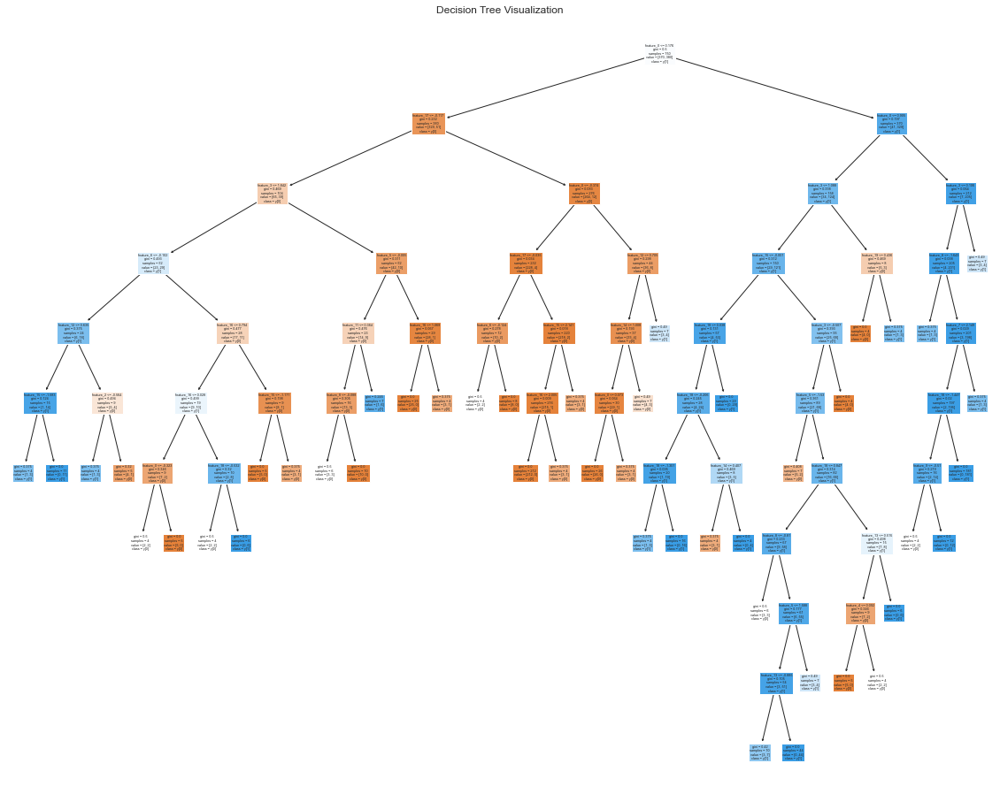

In [143]:
from sklearn.tree import DecisionTreeClassifier, plot_tree

# Visualize the Decision Tree
plt.figure(figsize=(20,16))
plot_tree(best_dt, filled=True, feature_names=df_cleaned_binary.drop('quality', axis=1).columns, class_names=True)
plt.title('Decision Tree Visualization')
plt.show()


### XGBoost

In [144]:
import xgboost as xgb

X = df_cleaned_binary.drop('quality', axis=1)
y = df_cleaned_binary['quality']

# Split the data into a training set and a test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Instantiate an XGBoost classifier object
xgb_classifier = xgb.XGBClassifier(random_state=42)

# Fit the classifier to the training data
xgb_classifier.fit(X_train, y_train)

# Predict the labels of the test set
y_pred = xgb_classifier.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Accuracy: {accuracy}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')

Accuracy: 0.855
Confusion Matrix:
[[87 15]
 [14 84]]
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.85      0.86       102
           1       0.85      0.86      0.85        98

    accuracy                           0.85       200
   macro avg       0.85      0.86      0.85       200
weighted avg       0.86      0.85      0.86       200



#### BP & Hyperparameter Improvement

In [145]:
X = df_cleaned_binary.drop('quality', axis=1)
y = df_cleaned_binary['quality']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

xgb_classifier = xgb.XGBClassifier(random_state=42)

# Define the grid of hyperparameters to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
}

# Set up the grid search
grid_search = GridSearchCV(estimator=xgb_classifier, param_grid=param_grid, cv=3, scoring='accuracy', n_jobs=-1, verbose=2)

# Perform the grid search on the training data
grid_search.fit(X_train, y_train)

# Best parameters
print("Best parameters found: ", grid_search.best_params_)

# Use the best estimator to make predictions
best_xgb_classifier = grid_search.best_estimator_
y_pred = best_xgb_classifier.predict(X_test)

# Evaluate the optimized classifier
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

print(f'Optimized Accuracy: {accuracy}')
print(f'Optimized Confusion Matrix:\n{conf_matrix}')
print(f'Optimized Classification Report:\n{class_report}')


Fitting 3 folds for each of 243 candidates, totalling 729 fits
Best parameters found:  {'colsample_bytree': 0.8, 'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100, 'subsample': 0.8}
Optimized Accuracy: 0.885
Optimized Confusion Matrix:
[[88 14]
 [ 9 89]]
Optimized Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.86      0.88       102
           1       0.86      0.91      0.89        98

    accuracy                           0.89       200
   macro avg       0.89      0.89      0.88       200
weighted avg       0.89      0.89      0.88       200



### Gradient Boosting Machines (GBM) Model

In [146]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler

X = df_cleaned_binary.drop('quality', axis=1)
y = df_cleaned_binary['quality']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Optional: Standardize features by removing the mean and scaling to unit variance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize the Gradient Boosting Classifier
gbm_classifier = GradientBoostingClassifier(random_state=42)

# Fit the classifier to the training data
gbm_classifier.fit(X_train_scaled, y_train)

# Predict the labels of the test set
y_pred = gbm_classifier.predict(X_test_scaled)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

# Print evaluation results
print(f'GBM Model Accuracy: {accuracy}')
print(f'Confusion Matrix:\n{conf_matrix}')
print(f'Classification Report:\n{class_report}')


GBM Model Accuracy: 0.885
Confusion Matrix:
[[88 14]
 [ 9 89]]
Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.86      0.88       102
           1       0.86      0.91      0.89        98

    accuracy                           0.89       200
   macro avg       0.89      0.89      0.88       200
weighted avg       0.89      0.89      0.88       200



#### BP & Hyperparameter Improvement

In [147]:

X = df_cleaned_binary.drop('quality', axis=1)
y = df_cleaned_binary['quality']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize features by removing the mean and scaling to unit variance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize the Gradient Boosting Classifier
gbm_classifier = GradientBoostingClassifier(random_state=42)

# Define the grid of parameters to search
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'min_samples_split': [2, 4],
    'min_samples_leaf': [1, 2],
    'max_features': ['sqrt', 'log2', None]
}

# Setup GridSearchCV to find the best parameters
grid_search = GridSearchCV(estimator=gbm_classifier, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=2)

# Fit GridSearchCV
grid_search.fit(X_train_scaled, y_train)

# Best parameters found
print("Best parameters found: ", grid_search.best_params_)

# Use the best estimator to make predictions
best_gbm_classifier = grid_search.best_estimator_
y_pred = best_gbm_classifier.predict(X_test_scaled)

# Evaluate the optimized classifier
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

# Print the optimized model evaluation results
print(f'Optimized GBM Model Accuracy: {accuracy}')
print(f'Optimized Confusion Matrix:\n{conf_matrix}')
print(f'Optimized Classification Report:\n{class_report}')


Fitting 5 folds for each of 324 candidates, totalling 1620 fits
Best parameters found:  {'learning_rate': 0.2, 'max_depth': 4, 'max_features': None, 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 200}
Optimized GBM Model Accuracy: 0.88
Optimized Confusion Matrix:
[[88 14]
 [10 88]]
Optimized Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.86      0.88       102
           1       0.86      0.90      0.88        98

    accuracy                           0.88       200
   macro avg       0.88      0.88      0.88       200
weighted avg       0.88      0.88      0.88       200



Out of all the instances in the test dataset, approximately 73.08% were classified correctly by the KNN model.

If you have only one class in y_test, you need to revisit your data splitting process

Assuming your data splitting process is correct and you want to continue with the analysis, you may want to ensure your data is properly balanced

Assuming you have balanced classes and want to proceed

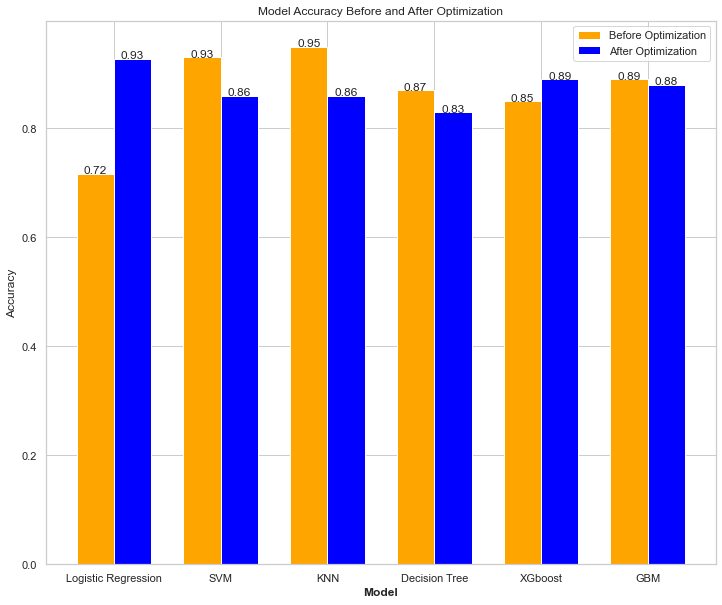

In [148]:
# We will create a grouped bar chart to display the data before and after optimization.

import matplotlib.pyplot as plt
import numpy as np

# Data for plotting
models = ['Logistic Regression', 'SVM', 'KNN', 'Decision Tree', 'XGboost', 'GBM']
accuracy_before = [0.7165413533834587, 0.93, 0.95, 0.87, 0.85, 0.89]
accuracy_after = [0.928, 0.86, 0.86, 0.83, 0.89, 0.88]

# Positions of the groups on the x-axis
barWidth = 0.35
r1 = np.arange(len(accuracy_before))
r2 = [x + barWidth for x in r1]

# Create the bars
plt.figure(figsize=(12, 10), facecolor='white')
bars1 = plt.bar(r1, accuracy_before, color='orange', width=barWidth, label='Before Optimization')
bars2 = plt.bar(r2, accuracy_after, color='blue', width=barWidth, label='After Optimization')

# Add labels and title
plt.xlabel('Model', fontweight='bold')
plt.xticks([r + barWidth/2 for r in range(len(accuracy_before))], models)
plt.ylabel('Accuracy')
plt.title('Model Accuracy Before and After Optimization')

# Create labels
label_position_before = [height for height in accuracy_before]
label_position_after = [height for height in accuracy_after]

# Text on the top of each bar
for i in range(len(models)):
    plt.text(r1[i], label_position_before[i], f'{accuracy_before[i]:.2f}', ha='center')
    plt.text(r2[i], label_position_after[i], f'{accuracy_after[i]:.2f}', ha='center')

# Adding the legend and showing the plot
plt.legend()
plt.show()


### Predict good quality(High quality and good texture) through classification

#### Random forest classification

In [149]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

# Create a new binary 'good_quality' target variable based on criteria
df_texture['good_quality'] = ((df_texture['texture'] == 1) & (df_texture['quality'] > 5)).astype(int)

# Features and Labels
X = df_texture.drop(columns=['quality', 'texture', 'good_quality'])
y = df_texture['good_quality']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train the logistic regression model
model = LogisticRegression()
model.fit(X_train_scaled, y_train)

# Predict on the test data
y_pred = model.predict(X_test_scaled)

# Evaluate the model
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.82      0.94      0.88      1031
           1       0.58      0.29      0.39       299

    accuracy                           0.79      1330
   macro avg       0.70      0.62      0.63      1330
weighted avg       0.77      0.79      0.77      1330



Hyperparameter & BP Improvement

In [150]:

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import StandardScaler

# Features and Labels
X = df_texture.drop(columns=['quality', 'texture', 'good_quality'])
y = df_texture['good_quality']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=43)

# Standardize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize the classifier
rf = RandomForestClassifier(random_state=41)

# Define the parameter grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Fit GridSearchCV to find the best parameters
grid_search.fit(X_train_scaled, y_train)

# Retrieve the best parameters
best_params = grid_search.best_params_
print("Best parameters found: ", best_params)

# Use the best estimator found by GridSearchCV
best_rf = grid_search.best_estimator_

# Make predictions with the optimized model
y_pred = best_rf.predict(X_test_scaled)

# Calculate the accuracy of the optimized model
optimized_accuracy = accuracy_score(y_test, y_pred)

# Print out the optimized accuracy and classification report
print(f'Optimized Model Accuracy: {optimized_accuracy:.2%}')
print(classification_report(y_test, y_pred))


Best parameters found:  {'bootstrap': False, 'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 100}
Optimized Model Accuracy: 92.20%
              precision    recall  f1-score   support

           0       0.95      0.94      0.95       822
           1       0.82      0.85      0.83       242

    accuracy                           0.92      1064
   macro avg       0.89      0.90      0.89      1064
weighted avg       0.92      0.92      0.92      1064



#### Cross-Validation

In [151]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Features and Labels
X = df_texture.drop(columns=['quality', 'texture', 'good_quality'])
y = df_texture['good_quality']

# Standardize features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Initialize the classifier with the best parameters found previously
rf = RandomForestClassifier(
    n_estimators=300,
    max_depth=20,
    min_samples_split=2,
    min_samples_leaf=1,
    bootstrap=False,
    random_state=42
)

# Perform 10-fold cross-validation
cv_scores = cross_val_score(rf, X_scaled, y, cv=10)

# Calculate the mean and standard deviation of the cross-validation scores
cv_scores_mean = cv_scores.mean()
cv_scores_std = cv_scores.std()

print(f'Cross-Validation Accuracy: {cv_scores_mean:.2%} (std: {cv_scores_std:.2%})')


Cross-Validation Accuracy: 90.62% (std: 2.65%)


#### Prevent overfitting through two regularization comparisons of different degrees.

In [152]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import StandardScaler

# Preprocess features
scaler = StandardScaler().fit(df_texture.drop(columns=['quality', 'texture', 'good_quality']))
X_scaled = scaler.transform(df_texture.drop(columns=['quality', 'texture', 'good_quality']))
y = df_texture['good_quality']

# Split the data
X_train_scaled, X_test_scaled, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Initialize the classifier with regularization parameters
rf = RandomForestClassifier(
    n_estimators=300, 
    max_depth=10,  # Reduced from previously optimized, if it was higher
    min_samples_split=4, 
    min_samples_leaf=2, 
    max_features='sqrt',  # Considering sqrt of total features
    random_state=42
)

# Train the model
rf.fit(X_train_scaled, y_train)

# Make predictions
y_pred = rf.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy with Regularization: {accuracy:.2%}')
print(classification_report(y_test, y_pred))


Accuracy with Regularization: 93.14%
              precision    recall  f1-score   support

           0       0.96      0.95      0.96       822
           1       0.85      0.85      0.85       242

    accuracy                           0.93      1064
   macro avg       0.90      0.90      0.90      1064
weighted avg       0.93      0.93      0.93      1064



In [153]:

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Preprocess features
X_scaled = scaler.fit_transform(df_texture.drop(columns=['quality', 'texture', 'good_quality']))
y = df_texture['good_quality']

# Split the data
X_train_scaled, X_test_scaled, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Initialize the classifier with further regularization parameters
rf_more_regularized = RandomForestClassifier(
    n_estimators=300, 
    max_depth=8,  # Further reduced
    min_samples_split=10,  # Increased
    min_samples_leaf=5,  # Increased
    max_features='sqrt',  # Keeping as 'sqrt' but this can also be reduced if necessary
    random_state=42
)

# Train the more regularized model
rf_more_regularized.fit(X_train_scaled, y_train)

# Make predictions
y_pred_more_regularized = rf_more_regularized.predict(X_test_scaled)

# Evaluate the more regularized model's performance
accuracy_more_regularized = accuracy_score(y_test, y_pred_more_regularized)
print(f'Accuracy with More Regularization: {accuracy_more_regularized:.2%}')
print(classification_report(y_test, y_pred_more_regularized))


Accuracy with More Regularization: 92.48%
              precision    recall  f1-score   support

           0       0.94      0.96      0.95       822
           1       0.86      0.80      0.83       242

    accuracy                           0.92      1064
   macro avg       0.90      0.88      0.89      1064
weighted avg       0.92      0.92      0.92      1064



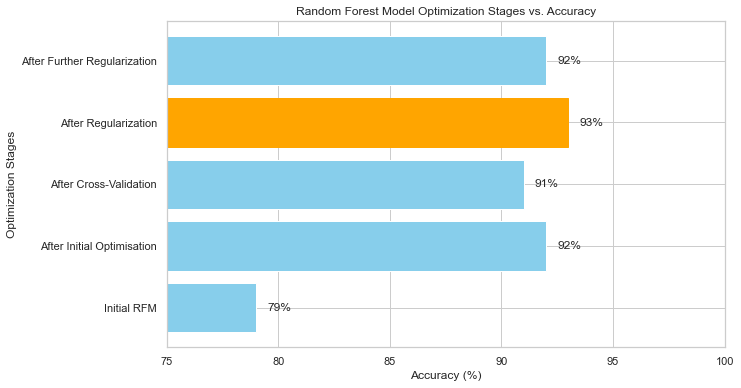

In [154]:

# Example data
stages = ['Initial RFM', 'After Initial Optimisation', 'After Cross-Validation', 'After Regularization','After Further Regularization']
accuracies = [79, 92, 91, 93,92]  # Example accuracies in percent

# Create the horizontal bar chart with annotations for all accuracies and highlight the highest accuracy
plt.figure(figsize=(10, 6))
bars = plt.barh(stages, accuracies, color='skyblue')

# Title and labels
plt.title('Random Forest Model Optimization Stages vs. Accuracy')
plt.xlabel('Accuracy (%)')
plt.ylabel('Optimization Stages')
plt.xlim([75, 100])  # Set x-axis limits to make differences more visible

# Highlight the bar with the highest accuracy
highest_accuracy = max(accuracies)
highest_index = accuracies.index(highest_accuracy)
bars[highest_index].set_color('orange')

# Annotation for all accuracies
for bar, accuracy in zip(bars, accuracies):
    plt.text(accuracy + 0.5, bar.get_y() + bar.get_height() / 2, f'{accuracy}%', va='center')

# Display the plot
plt.grid(True)
plt.show()


# Ending